<h1> <center>Implementing and Evaluating a Series of Regression Models</center></h1>
    
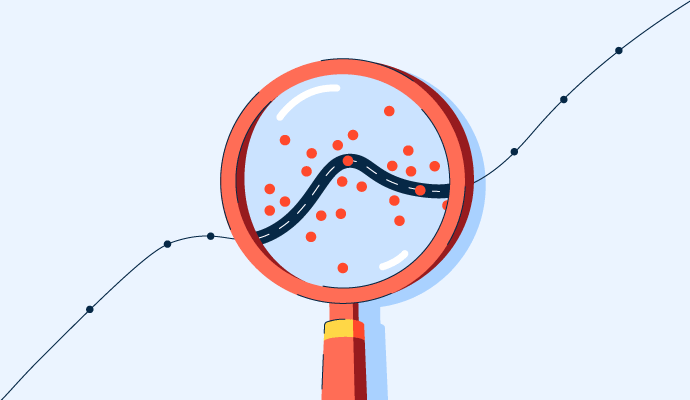
    

# Table of Contents
- Introduction
- Exploratory Data Analysis
- Data Preparation
- Prepared Data Review
- Regression Modeling
- Select Models
- Conclusion

# Introduction
The dataset comprised of information pertaining to NY State High School graduation metrics for the 2018-2019 school year. The dataset is sourced from the NY State Education Department [(NYSED)](https://data.nysed.gov/downloads.php). The dataset is comprised of more than 73,000 observations, each of which pertains to a particular NY State school district and associated sub groupings/categorizations of high school students who had been enrolled for at least 4 years as of the end of the 2018-2019 school year. 

__A data dictionary describing the attributes contained within the file is provided below.__

|Data Set Attribute |Description|
|:-------------------|:-----------|
|report_school_year |Indicates school year for which high school graduation info is being reported|
|aggregation_index |Numeric code identifying manner in which high school graduation data has been aggregated|
|aggregation_type |Text description of how high school graduation data has been aggregated|
|aggregation_name | Name of city school with district |
|nrc_code |Numeric code identifying "needs / resource capacity", which is an indicator of the type of school district|
|nrc_desc |Text description of the type of school district|
|county_code |Numeric code for county name|
|county_name |Full name of applicable NY State county|
|nyc_ind |Indicates whether or not the school district resides within the borders of NYC|
|membership_desc |Indicates school year in which students first enrolled in High School|
|subgroup_code |Numeric code identifying student subgrouping|
|subgroup_name |Text description of student subgrouping. Note that a student may belong to MORE THAN ONE subgrouping (e.g., "Female", "Hispanic", "Not English Language Learner", etc.)|
|enroll_cnt |How many students of the indicated subgrouping were enrolled during the given school year|
|grad_cnt |How many enrolled students of the indicated subgrouping graduated at the end of the given school year|
|grad_pct |What percentage of enrolled students of the indicated subgrouping graduated at the end for the given school year|
|local_cnt |How many enrolled students of the indicated subgrouping were awarded a "Local" diploma|
|local_pct |What percentage of enrolled students of the indicated subgrouping were awarded a "Local" diploma|
|reg_cnt |How many enrolled students of the indicated subgrouping were awarded a "Regents" diploma|
|reg_pct |What percentage of enrolled students of the indicated subgrouping were awarded a "Regents" diploma|
|reg_adv_cnt |How many enrolled students of the indicated subgrouping were awarded a "Regents Advanced" diploma|
|reg_adv_pct |What percentage of enrolled students of the indicated subgrouping were awarded a "Regents Advanced" diploma|
|non_diploma_credential_cnt |How many enrolled students of the indicated subgrouping achieved a non diploma credential|      |non_diploma_credential_pct |What percentage of enrolled students of the indicated subgrouping achieved a non-diploma credential|
|still_enrolled_cnt |How many enrolled students of the indicated subgrouping did not graduate but were still_enrolled|
|still_enrolled_pct |What percentage of enrolled students of the indicated subgrouping did not graduate but were still_enrolled|
|ged_cnt |How many enrolled students of the indicated subgrouping were awarded a "GED" diploma|
|ged_pct |What percentage of enrolled students of the indicated subgrouping were awarded a "GED" diploma|
|dropout_cnt |How many enrolled students of the indicated subgrouping discontinued their high school enrollment during the school year|
|dropout_pct |What percentage of enrolled students of the indicated subgrouping discontinued their high school enrollment during the school year|

## Project Goal
The main objective for this Project is to apply the full data science project lifecycle to the implementation of a series 
of regression models. Our work should include EDA, data preparation (including the use of attribute transforms as needed), feature selection, and a thorough evaluation of model performance metrics. 

The response variable we will be modeling is the data set’s “dropout_cnt” attribute, which represents the number of enrolled students who discontinued their enrollment (i.e., “dropped out”) from within the indicated school district or student subgroup . 
Therefore, our task is to construct and compare/contrast a series of regression models (after completing the necessary EDA and data prep work) that predict the number of student “dropouts” relative to certain properties/characteristics of a given school district + associated student subgrouping. 

## Methodology
- Import the necessary python libraries.
- Load the data into Github Repository and then upload that data into python Jupyter Notebook using Pandas reader function.
- Read the data and their information like number of observations, features, data type, individual features missing values, punctuation, and other anomalies inside each feature.
- Visualize the statistical description of each features, creating Univariate, Bivariate, Multivariate analysis, dealing with missing values, duplicate values, outliers, collinearity, feature selection, standardization, model building and compare model performance among models by performance metrics.

In [1]:
%matplotlib inline

## Data Loading & Manipulation
In this section we will import the python libraries, packages for our project work. Also we will see the basic overview of the dataset like number of attributes, observations, data type and some more useful information in details.


In [2]:
# Importing libraries 
import numpy as np
import pandas as pd
#Install shap module below if missing in your environment
#!pip install shap

#Install xgboost module below if missing in your environment
#!pip install xgboost

# Import library for visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objs as go


import math
import missingno as msno
from sklearn.impute import KNNImputer
import scipy.stats as stats
from scipy.stats import boxcox
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.decomposition import PCA
from sklearn.linear_model import PoissonRegressor, LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error
import statsmodels.api as sm
import shap
import xgboost as xgb

# Import filterwarnngs  from warnings to ignore warnings
import warnings
warnings.filterwarnings("ignore")

# Sets the default figure size to 10 inches in width and 6 inches in height
plt.rcParams['figure.figsize'] = [10, 6] 

In [3]:
# Read a CSV file from the provided URL and store it in a pandas DataFrame (df)
school_report_df = pd.read_csv("https://raw.githubusercontent.com/mamun21616/DAV-6150/main/Project1_Data.csv")
# Display the first few rows of the DataFrame to get a quick overview of the data
school_report_df.head()


,report_school_year,aggregation_index,aggregation_type,aggregation_name,nrc_code,nrc_desc,county_code,county_name,nyc_ind,membership_desc,...,reg_adv_cnt,reg_adv_pct,non_diploma_credential_cnt,non_diploma_credential_pct,still_enr_cnt,still_enr_pct,ged_cnt,ged_pct,dropout_cnt,dropout_pct
0,2018-19,3,District,ALBANY CITY SCHOOL DISTRICT,3,Urban-Suburban High Needs,1,ALBANY,0,2013 Total Cohort - 6 Year Outcome,...,91,14%,16,2%,30,5%,0,0%,148,22%
1,2018-19,3,District,ALBANY CITY SCHOOL DISTRICT,3,Urban-Suburban High Needs,1,ALBANY,0,2013 Total Cohort - 6 Year Outcome,...,47,15%,2,1%,11,3%,0,0%,65,20%
2,2018-19,3,District,ALBANY CITY SCHOOL DISTRICT,3,Urban-Suburban High Needs,1,ALBANY,0,2013 Total Cohort - 6 Year Outcome,...,44,13%,14,4%,19,6%,0,0%,83,25%
3,2018-19,3,District,ALBANY CITY SCHOOL DISTRICT,3,Urban-Suburban High Needs,1,ALBANY,0,2013 Total Cohort - 6 Year Outcome,...,-,-,-,-,-,-,-,-,-,-
4,2018-19,3,District,ALBANY CITY SCHOOL DISTRICT,3,Urban-Suburban High Needs,1,ALBANY,0,2013 Total Cohort - 6 Year Outcome,...,23,6%,10,3%,18,5%,0,0%,91,25%


In [4]:
# Display the dataset total attributes and observations
school_report_df.shape

(73152, 29)

The total number of observations are 73152 and attributes are 29.

In [5]:
# Show the details about the dataset information
school_report_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73152 entries, 0 to 73151
Data columns (total 29 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   report_school_year          73152 non-null  object
 1   aggregation_index           73152 non-null  int64 
 2   aggregation_type            73152 non-null  object
 3   aggregation_name            73152 non-null  object
 4   nrc_code                    73152 non-null  int64 
 5   nrc_desc                    73152 non-null  object
 6   county_code                 73152 non-null  int64 
 7   county_name                 73152 non-null  object
 8   nyc_ind                     73152 non-null  int64 
 9   membership_desc             73152 non-null  object
 10  subgroup_code               73152 non-null  int64 
 11  subgroup_name               73152 non-null  object
 12  enroll_cnt                  73152 non-null  object
 13  grad_cnt                    73152 non-null  ob

Dataset observation:

- This is a type of Pandas Dataframe.

- Index ranges from 0-73,151.

- Total number of attributes are 29.

- Majority of the attributes showing  categorical data type. Only few of them are Numerical. In reality thats not true. Most of the numerical columns labeled as categorical. So to verify again we need to check the data type from the dataset for each feature.

- Dataset used computer memory 16.2+ MB.

In [6]:
# Check the data types for each variable
school_report_df.dtypes

report_school_year            object
aggregation_index              int64
aggregation_type              object
aggregation_name              object
nrc_code                       int64
nrc_desc                      object
county_code                    int64
county_name                   object
nyc_ind                        int64
membership_desc               object
subgroup_code                  int64
subgroup_name                 object
enroll_cnt                    object
grad_cnt                      object
grad_pct                      object
local_cnt                     object
local_pct                     object
reg_cnt                       object
reg_pct                       object
reg_adv_cnt                   object
reg_adv_pct                   object
non_diploma_credential_cnt    object
non_diploma_credential_pct    object
still_enr_cnt                 object
still_enr_pct                 object
ged_cnt                       object
ged_pct                       object
d

Obsertvation: Most features data types are not correct, we will make it right format in the following step.

In [7]:
# List of columns to convert to numeric
columns_to_convert = ['enroll_cnt', 'grad_cnt', 'local_cnt', 'reg_cnt', 'reg_adv_cnt',
                      'non_diploma_credential_cnt', 'still_enr_cnt', 'ged_cnt', 'dropout_cnt',
                      'grad_pct', 'local_pct', 'reg_pct', 'reg_adv_pct',
                      'non_diploma_credential_pct', 'still_enr_pct', 'ged_pct', 'dropout_pct']

# Convert columns to numeric
school_report_df[columns_to_convert] = school_report_df[columns_to_convert].apply(pd.to_numeric, errors='coerce')

In [8]:
# Check data types after changing festures data tye
school_report_df.dtypes

report_school_year             object
aggregation_index               int64
aggregation_type               object
aggregation_name               object
nrc_code                        int64
nrc_desc                       object
county_code                     int64
county_name                    object
nyc_ind                         int64
membership_desc                object
subgroup_code                   int64
subgroup_name                  object
enroll_cnt                    float64
grad_cnt                      float64
grad_pct                      float64
local_cnt                     float64
local_pct                     float64
reg_cnt                       float64
reg_pct                       float64
reg_adv_cnt                   float64
reg_adv_pct                   float64
non_diploma_credential_cnt    float64
non_diploma_credential_pct    float64
still_enr_cnt                 float64
still_enr_pct                 float64
ged_cnt                       float64
ged_pct     

After changing data type, now looks better for all features data type in right format.

## Taking Subset from the all features which can be most relevant for our EDA purposes.

For example we have some variables like report_school_year, nrc_code, country_code, aggregation_index, aggregation_type. We will ignore these columns because they have no meaning for data analysis. We use all data for year 2018-2019.No need to show this duration for each row. These features can be use for reference and understanding. In addition to that, some columns are duplicate like count and percent. So we will keep only count column instead of percentage because they have same meaning.

The following subset of features we will work from now.

In [9]:
# Selecting only the desired features (columns) from the original dataframe
selected_features = ['aggregation_name', 'nrc_desc', 'county_name', 'nyc_ind', 'membership_desc', 'subgroup_name',
                     'enroll_cnt', 'grad_cnt', 'local_cnt', 'reg_cnt', 'reg_adv_cnt', 'non_diploma_credential_cnt',
                     'still_enr_cnt', 'ged_cnt', 'dropout_cnt']

# Creating a new dataframe with only the selected features
df_selected_features = school_report_df[selected_features]

# Displaying the new dataframe
df_selected_features.head()

,aggregation_name,nrc_desc,county_name,nyc_ind,membership_desc,subgroup_name,enroll_cnt,grad_cnt,local_cnt,reg_cnt,reg_adv_cnt,non_diploma_credential_cnt,still_enr_cnt,ged_cnt,dropout_cnt
0,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2013 Total Cohort - 6 Year Outcome,All Students,658.0,464.0,63.0,310.0,91.0,16.0,30.0,0.0,148.0
1,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2013 Total Cohort - 6 Year Outcome,Female,324.0,246.0,30.0,169.0,47.0,2.0,11.0,0.0,65.0
2,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2013 Total Cohort - 6 Year Outcome,Male,334.0,218.0,33.0,141.0,44.0,14.0,19.0,0.0,83.0
3,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2013 Total Cohort - 6 Year Outcome,American Indian/Alaska Native,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2013 Total Cohort - 6 Year Outcome,Black,367.0,248.0,42.0,183.0,23.0,10.0,18.0,0.0,91.0


In [10]:
# Check the membership description feature
df_selected_features['membership_desc'].value_counts()

2015 Total Cohort - 4 Year Outcome                  12299
2015 Total Cohort - 4 Year Outcome - August 2019    12299
2014 Total Cohort - 5 Year Outcome                  12257
2014 Total Cohort - 5 Year Outcome - August 2019    12257
2013 Total Cohort - 6 Year Outcome                  12020
2013 Total Cohort - 6 Year Outcome - August 2019    12020
Name: membership_desc, dtype: int64

__From the value count method We can see that every year we have two observation. That is not normal. We will merge these data in one year like for 1013, 2014, 2015 with 6, 5, 4 year outcome.__

__As we can see that each year has two outcomes, that can be misleading. So we can do merge into one year and their duration of outcomes__

In [11]:
# Extract the year and outcome information using regular expressions
df_selected_features['year'] = df_selected_features['membership_desc'].str.extract(r'(\d{4})')

# Set new row value based on specific conditions
df_selected_features['membership_desc'] = df_selected_features['year'].apply(
    lambda x: '2013-19 6yr outcome' if x == '2013' else ('2014-19 5yr outcome' if x == '2014' else '2015-19 4yr outcome')
)

In [12]:
# Display the outcomes for each year with their duration
df_selected_features['membership_desc'].value_counts()

2015-19 4yr outcome    24598
2014-19 5yr outcome    24514
2013-19 6yr outcome    24040
Name: membership_desc, dtype: int64

Now its look way better than earlier. As we have succesfully merged the years and outcomes accordingly.

# Exploratory Data Analysis
Analyzing a data set for purposes of summarizing its characteristics, identifying relationships between its attributes, and discovering patterns, trends, outliers, missing values and invalid values within the data. In this EDA process start with Univariate analysis, bivariate analysis and multivariate analysis.

Now we will present the Descriptive Statistics for each variable.

In [13]:
# Display descriptive statistics for all columns, including object and categorical types
df_selected_features.describe(include = 'all')

,aggregation_name,nrc_desc,county_name,nyc_ind,membership_desc,subgroup_name,enroll_cnt,grad_cnt,local_cnt,reg_cnt,reg_adv_cnt,non_diploma_credential_cnt,still_enr_cnt,ged_cnt,dropout_cnt,year
count,73152,73152,73152,73152.000000,73152,73152,39674.000000,39674.000000,39674.000000,39674.000000,39674.000000,39674.000000,39674.000000,39674.000000,39674.000000,73152
unique,680,6,62,NaN,3,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
top,KINGSTON CITY SCHOOL DISTRICT,Average Needs,SUFFOLK,NaN,2015-19 4yr outcome,All Students,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015
freq,138,35322,6526,NaN,24598,4074,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24598
mean,NaN,NaN,NaN,0.055255,NaN,NaN,192.120079,161.178354,12.340903,86.804708,62.032742,1.924485,11.299516,1.377577,16.239225,NaN
std,NaN,NaN,NaN,0.228479,NaN,NaN,439.972474,361.294773,32.046302,225.795826,132.777866,6.498913,40.766672,4.949389,50.129834,NaN
min,NaN,NaN,NaN,0.000000,NaN,NaN,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,NaN,NaN,NaN,0.000000,NaN,NaN,25.000000,20.000000,1.000000,10.000000,4.000000,0.000000,0.000000,0.000000,1.000000,NaN
50%,NaN,NaN,NaN,0.000000,NaN,NaN,66.000000,57.000000,4.000000,27.000000,18.000000,0.000000,2.000000,0.000000,3.000000,NaN
75%,NaN,NaN,NaN,0.000000,NaN,NaN,179.000000,156.000000,10.000000,69.000000,62.000000,2.000000,5.000000,1.000000,9.000000,NaN


__Observations__

- At first we can see that aggregation name, nrc description, country name, nyc ind, membership description, subgroup name, year columns have total observations 73152 but rest of the numerical features have not full observations, they contain only 39674 observations. We need to look into that missing observations.
- For categorical features we derived total number of unique count, top object and frequency for each variable.
- For numerical attributes we derived mean, median, 25%, 75%, minimum and maximum value for each and individual feature. 

## Check the duplicate values

In [14]:
# Find duplicate rows in the DataFrame based on all columns
duplicates = df_selected_features[df_selected_features.duplicated()]

# Display duplicate rows
duplicates

,aggregation_name,nrc_desc,county_name,nyc_ind,membership_desc,subgroup_name,enroll_cnt,grad_cnt,local_cnt,reg_cnt,reg_adv_cnt,non_diploma_credential_cnt,still_enr_cnt,ged_cnt,dropout_cnt,year
69,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2014-19 5yr outcome,American Indian/Alaska Native,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014
74,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2014-19 5yr outcome,Multiracial,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014
76,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2014-19 5yr outcome,Students with Disabilities,114.0,54.0,40.0,14.0,0.0,14.0,12.0,1.0,33.0,2014
79,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2014-19 5yr outcome,Formerly English Language Learner,6.0,6.0,1.0,4.0,1.0,0.0,0.0,0.0,0.0,2014
82,ALBANY CITY SCHOOL DISTRICT,Urban-Suburban High Needs,ALBANY,0,2014-19 5yr outcome,Migrant,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73147,DUNDEE CENTRAL SCHOOL DISTRICT,Rural High Needs,YATES,0,2013-19 6yr outcome,Not Migrant,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013
73148,DUNDEE CENTRAL SCHOOL DISTRICT,Rural High Needs,YATES,0,2013-19 6yr outcome,Homeless,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013
73149,DUNDEE CENTRAL SCHOOL DISTRICT,Rural High Needs,YATES,0,2013-19 6yr outcome,Not Homeless,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013
73150,DUNDEE CENTRAL SCHOOL DISTRICT,Rural High Needs,YATES,0,2013-19 6yr outcome,Not in Foster Care,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013


 There are 31730 rows that have identical values in all columns with some previous row. This is really huge , its almost 50% of our full data.
 We want to keep the first occurrence of each duplicated row and drop the subsequent ones.

In [15]:
# Remove exact duplicates
df_selected_features.drop_duplicates(keep = 'first', inplace=True)

In [16]:
# Display the number of observations remain after removing the duplicates
len(df_selected_features)

41422

In [17]:
# Check agian if there is any duplicate rows exist yet or not
len(df_selected_features[df_selected_features.duplicated()])


0

Observation: We now have checked and verified that there are no more duplicate values as the result from the check shows zero duplicates.

## Identify null values

In [18]:
# Check for missing values
df_selected_features.isnull().sum()

aggregation_name                  0
nrc_desc                          0
county_name                       0
nyc_ind                           0
membership_desc                   0
subgroup_name                     0
enroll_cnt                    16739
grad_cnt                      16739
local_cnt                     16739
reg_cnt                       16739
reg_adv_cnt                   16739
non_diploma_credential_cnt    16739
still_enr_cnt                 16739
ged_cnt                       16739
dropout_cnt                   16739
year                              0
dtype: int64

In [19]:
# Calculate the percentage of missing values for each column
missing_percentages = df_selected_features.isnull().mean() * 100

# Display the percentage of missing values
print(missing_percentages)

aggregation_name               0.000000
nrc_desc                       0.000000
county_name                    0.000000
nyc_ind                        0.000000
membership_desc                0.000000
subgroup_name                  0.000000
enroll_cnt                    40.410893
grad_cnt                      40.410893
local_cnt                     40.410893
reg_cnt                       40.410893
reg_adv_cnt                   40.410893
non_diploma_credential_cnt    40.410893
still_enr_cnt                 40.410893
ged_cnt                       40.410893
dropout_cnt                   40.410893
year                           0.000000
dtype: float64


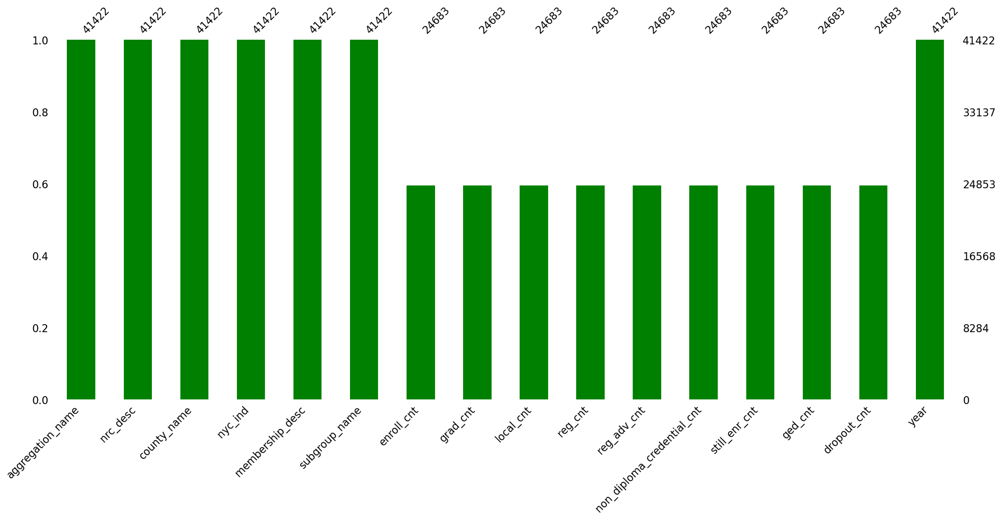

In [20]:
# Create a bar chart visualization of missing values
msno.bar(df_selected_features, color='green')

# Display the plot
plt.show();

Out of 16 variable, 9 variables contains  around 40% missing values, which are huge.  

## Outliers Detection

### Box plot for outlier detection

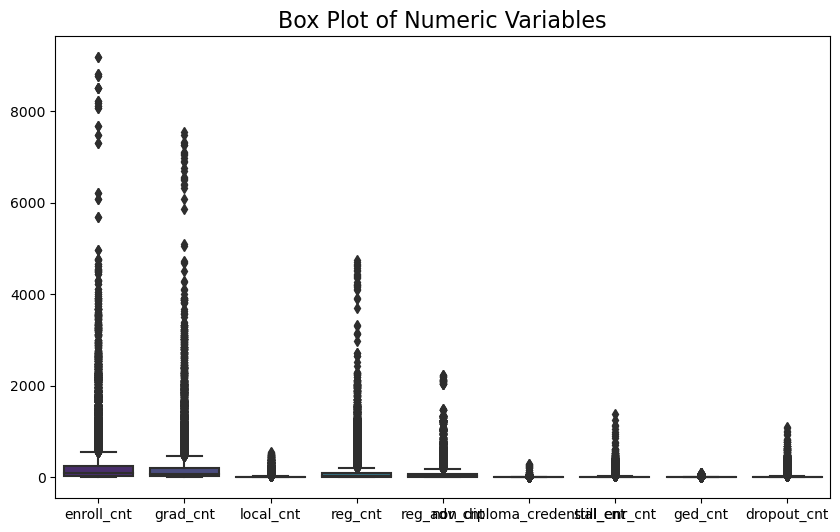

In [21]:
# Select the numerical columns from the DataFrame is named 'df_selected_features'
numeric_columns = df_selected_features.select_dtypes(include=['float64']).columns

# Create a Box plot for each numeric variable
sns.boxplot(data=df_selected_features[numeric_columns], palette='viridis')
# Set the title of the plot
plt.title('Box Plot of Numeric Variables', fontsize=16)
# Display the plot
plt.show();

Observation: We have noticed the presence of many outliers beyond the 'maximum' value of the interquartile range. Hence, the need to consider handling outlier in data preparation.

We will further investigate the outliers using QQ plots below and use our insights to determine our data preparation action on outliers.

### QQ plot for outliers detection

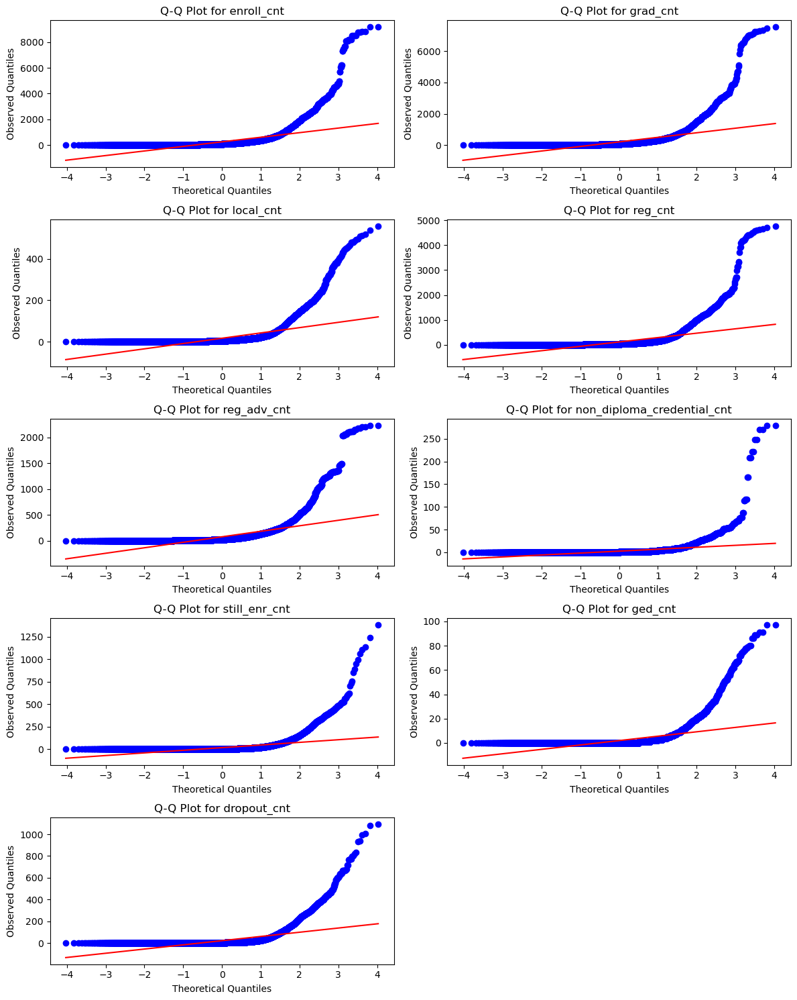

In [22]:
# Define function for qq plot 
def plot_qq_plots(data_frame):
    """
    Generate Q-Q plots for each numeric variable in a DataFrame.

    Parameters:
    - data_frame (pd.DataFrame): The input DataFrame containing numeric variables.

    Returns:
    None

    Example:
    plot_qq_plots(df_selected_features)
    """
    numeric_columns = data_frame.select_dtypes(include=['float64']).columns

    num_plots = len(numeric_columns)
    num_cols = 2
    num_rows = math.ceil(num_plots / num_cols)

    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(12, 3 * num_rows))

    for i, column in enumerate(numeric_columns):
        row, col = divmod(i, num_cols)
        ax = axes[row, col]

        stats.probplot(data_frame[column].dropna(), dist='norm', plot=ax)

        ax.set_title(f'Q-Q Plot for {column}')
        ax.set_xlabel('Theoretical Quantiles')
        ax.set_ylabel('Observed Quantiles')

    for i in range(num_plots, num_rows * num_cols):
        fig.delaxes(axes.flatten()[i])

    plt.tight_layout()
    plt.show()


# Call the function with our DataFrame
plot_qq_plots(df_selected_features)


__It is clearly visible for all the numerical features have outliers and due to outliers they are skewed.__

## Univariate Analysis

__Distribution for target Varibale Dropout_cnt__

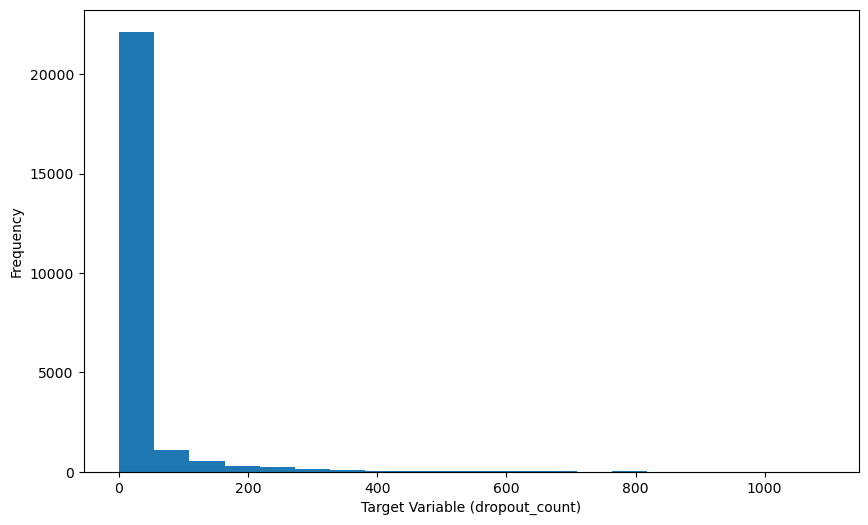

In [23]:
# Create a histogram for the 'dropout_cnt' column
plt.hist(df_selected_features['dropout_cnt'], bins=20)
# The 'bins' parameter specifies the number of bins (intervals) in the histogram.

# Set x-axis label
plt.xlabel("Target Variable (dropout_count)")

# Set y-axis label
plt.ylabel("Frequency")

# Display the plot
plt.show();

### Categorical Features Univariate Analysis

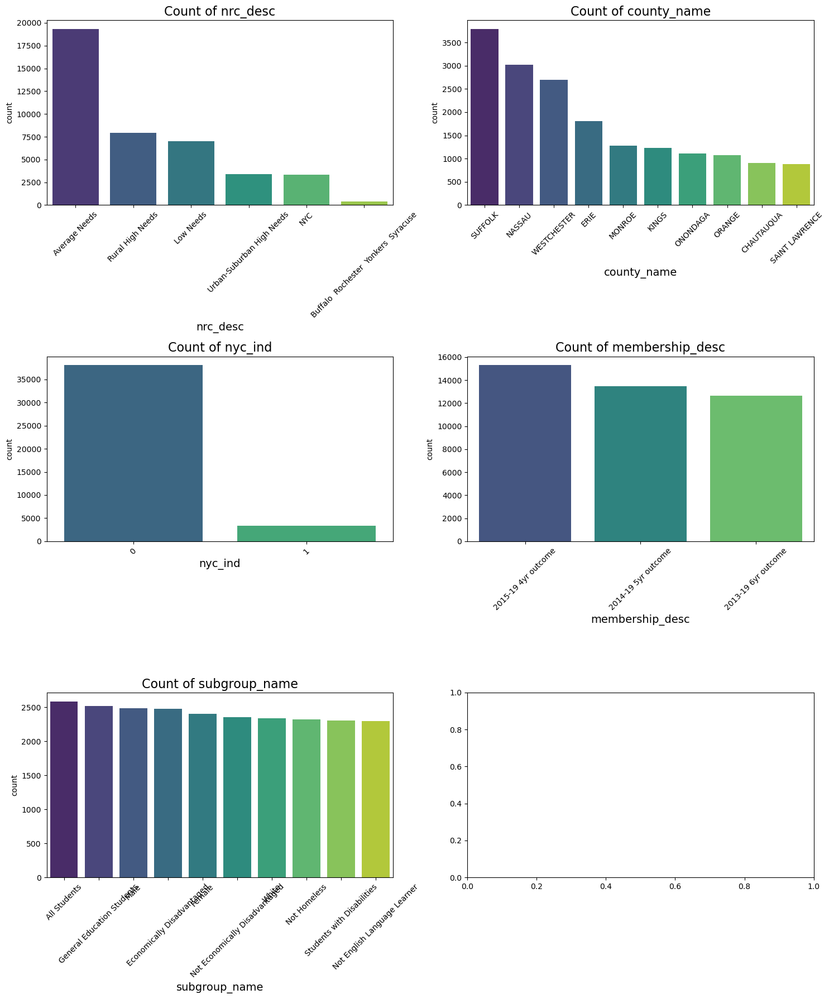

In [24]:
# Function to visualize counts of categorical variables side by side
def visualize_categorical_counts(dataframe, categorical_columns):
    """
    Visualize counts of categorical variables side by side using countplots.

    Parameters:
    - dataframe (pd.DataFrame): The input DataFrame containing the categorical variables.
    - categorical_columns (list): List of column names corresponding to categorical variables.

    Returns:
    None

    Example:
    visualize_categorical_counts(df_selected_features, ['nrc_desc', 'county_name', 'nyc_ind', 'membership_desc', 'subgroup_name'])
    """
    num_plots = len(categorical_columns)
    num_cols = min(num_plots, 2)  # Number of columns in each row

    # Calculate the number of rows needed
    num_rows = math.ceil(num_plots / num_cols)

    # Create subplots
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(15, 6 * num_rows))

    # Flatten the axes array for easy indexing
    axes = axes.flatten()

    for i, column in enumerate(categorical_columns):
        # Select the current axis
        ax = axes[i]

        # Countplot with title, x-axis label orientation, sorting, and top 10 categories
        sns.countplot(x=column, data=dataframe, order=dataframe[column].value_counts().index[:10], palette='viridis', ax=ax)
        ax.set_title(f'Count of {column}', fontsize=16)
        ax.set_xlabel(column, fontsize=14)
        ax.tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better visibility

    # Adjust layout and show the plots
    plt.tight_layout()
    plt.show()

# Assuming your DataFrame is named 'df_selected_features'
visualize_categorical_counts(df_selected_features, ['nrc_desc', 'county_name', 'nyc_ind', 'membership_desc', 'subgroup_name'])


NYSED classifies school districts by a measure that takes into account both their degree of pupil need and their fiscal capacity. This measure is the need/resource capacity (NRC) index. While the need/resource capacity index is a continuous measure, NYSED uses it as a categorical variable as well. SED has defined six need/resource categories: New York City, the Big Four City School Districts (Buffalo, Rochester, Syracuse and Yonkers), high need urban/suburban districts, high need rural districts, average need districts, and low need districts.[1]

Figure show from 2018-2019, the average need, high need rural districts and low needs debt payments (upper group) were the highest group. The lowest group comprised three need resource categories; the Big Four, NYC and high need urban/suburban categories. Although these need resource categories are very different from each other.

In case of Membership description highest value for 4 year outcome. 

For NYC_DEC most of the time school district was not out of borders, therefore 0 value count was higher than 1. One means out of border.

### Numerical Features Univaraite Analysis

In [25]:
def numerical_univariate_analysis(data, numerical_columns):
    """
    Generate a grid of Box Plots and Histograms for numerical columns in a DataFrame.

    Parameters:
    - data (pd.DataFrame): The input DataFrame containing numerical columns.
    - numerical_columns (list): List of column names corresponding to numerical variables.

    Returns:
    None

    Example:
    numerical_columns = ['enroll_cnt', 'grad_cnt', 'local_cnt', 'reg_cnt', 'reg_adv_cnt', 'non_diploma_credential_cnt',
                          'still_enr_cnt', 'ged_cnt', 'dropout_cnt']
    numerical_univariate_analysis(df_selected_features, numerical_columns)
    """
    rows = len(numerical_columns)
    fig = sp.make_subplots(rows=rows, cols=2, subplot_titles=["Box Plot", "Histogram"])

    for i, column in enumerate(numerical_columns, 1):
        # Box Plot
        trace_box = go.Box(x=data[column], name=column)
        fig.add_trace(trace_box, row=i, col=1)

        # Histogram
        trace_hist = go.Histogram(x=data[column], nbinsx=20, name=column)
        fig.add_trace(trace_hist, row=i, col=2)

        # Update x-axis and y-axis labels
        fig.update_xaxes(title_text=column, row=i, col=1)
        fig.update_xaxes(title_text=column, row=i, col=2)
        fig.update_yaxes(title_text="Count", row=i, col=2)

    # Update layout
    fig.update_layout(showlegend=False, height=rows * 400, title_text="Numerical Univariate Analysis")

    # Show the plot
    fig.show()

# Assuming df_selected_features is your DataFrame
numerical_columns = ['enroll_cnt', 'grad_cnt', 'local_cnt', 'reg_cnt', 'reg_adv_cnt', 'non_diploma_credential_cnt',
                     'still_enr_cnt', 'ged_cnt', 'dropout_cnt']
numerical_univariate_analysis(df_selected_features, numerical_columns)

As we already have see the outliers in previous section and now from univariate analysis plot of histogram and box plot we can also identify and make sure that due to outliers, missing values, we have skewed distribution. 

## Bivariate analysis 

### Relationship between Enrollment count and dropout count

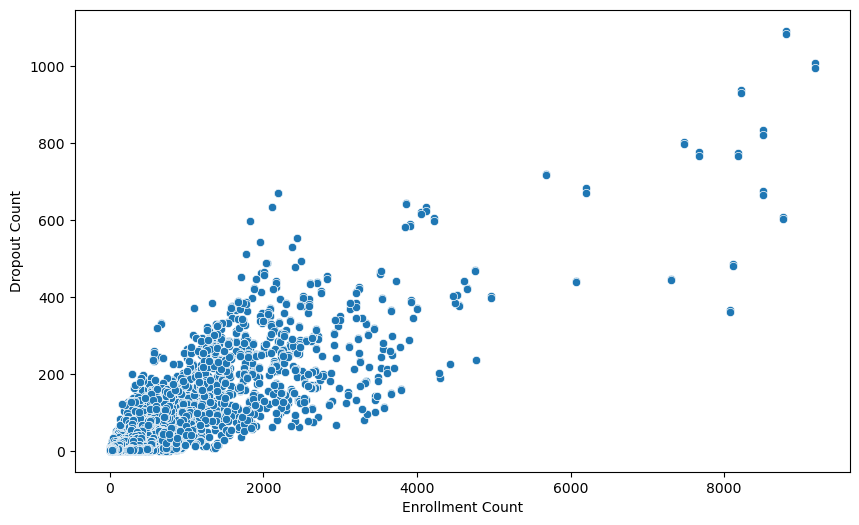

In [26]:
# Create a scatter plot
sns.scatterplot(x='enroll_cnt', y='dropout_cnt', data=df_selected_features)

# Set x-axis label
plt.xlabel('Enrollment Count')

# Set y-axis label
plt.ylabel('Dropout Count')

# Display the plot
plt.show()

Between Enrollment and Dropout count have positive relationship, which defines as the more enrollment the more dropout rate of percentage.

### Relationship between Local count and Dropout count

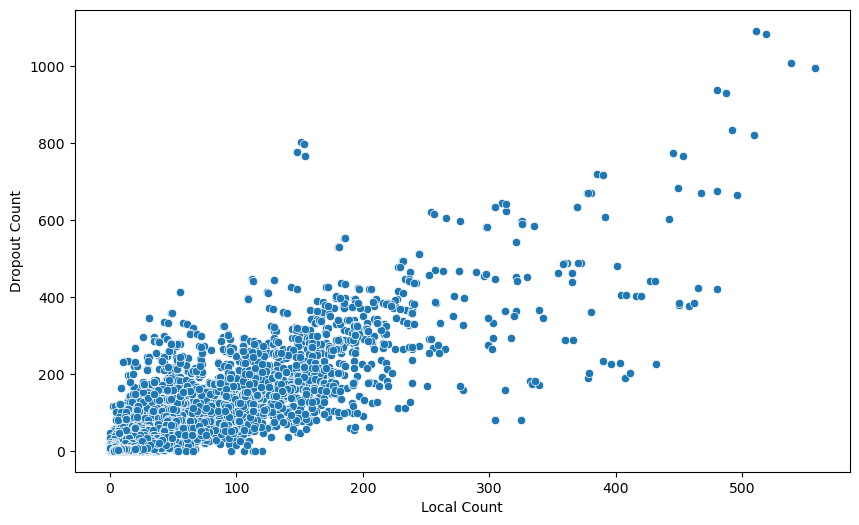

In [27]:
# Create a scatter plot
sns.scatterplot(x='local_cnt', y='dropout_cnt', data=df_selected_features)

# Set x-axis label
plt.xlabel('Local Count')

# Set y-axis label
plt.ylabel('Dropout Count')

# Display the plot
plt.show();

### Relationship between Enrollment count and Graduate count

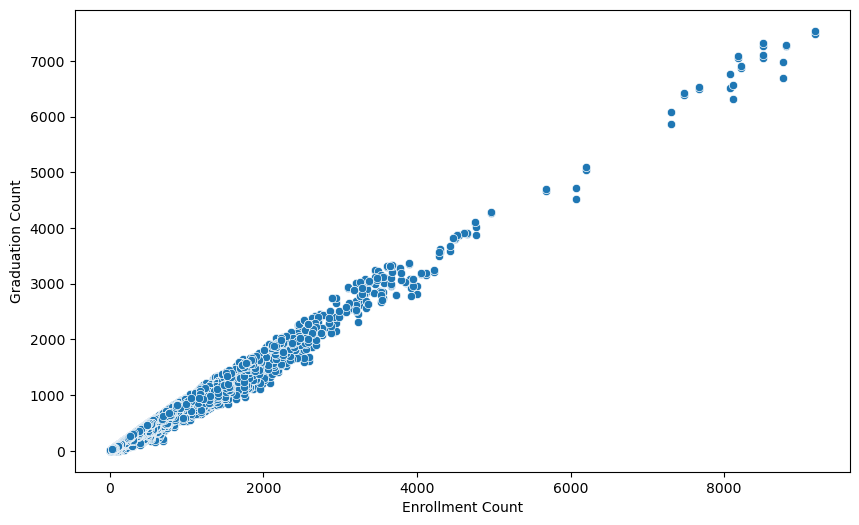

In [28]:
# Create a scatter plot
sns.scatterplot(x='enroll_cnt', y='grad_cnt', data=df_selected_features)

# Set x-axis label
plt.xlabel('Enrollment Count')

# Set y-axis label
plt.ylabel('Graduation Count')

# Display the plot
plt.show();

Then more enrollment the more graduation. These two features exists stronger positive relationship. But for our prediction purpose, we cannot use two inter correlated variable for prediction, we have to remove one of them to predict our dropout count.

### Relationship between Enrollment count and Regents Diploma count

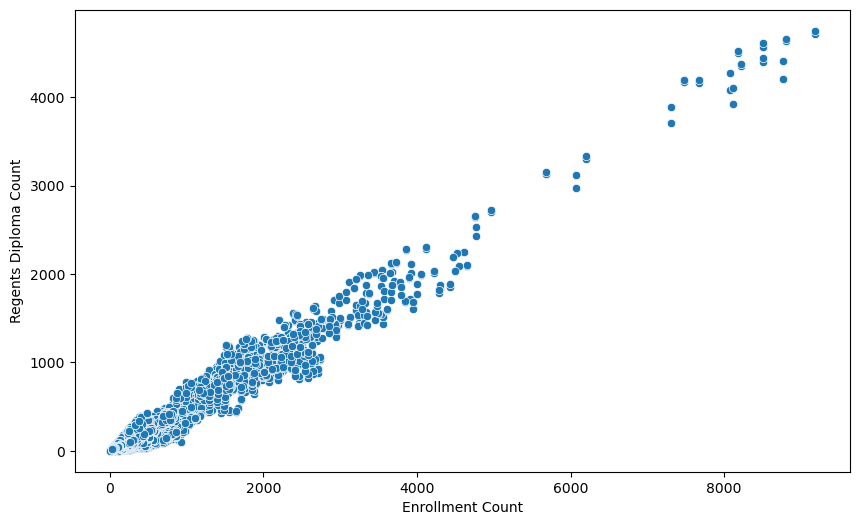

In [29]:
# Create a scatter plot
sns.scatterplot(x='enroll_cnt', y='reg_cnt', data=df_selected_features)

# Set x-axis label
plt.xlabel('Enrollment Count')

# Set y-axis label
plt.ylabel('Regents Diploma Count')

# Display the plot
plt.show();

Relationship between these to features are same as previous one, they are correlated each other.

### Display the Relationship between categorical features and Target feature

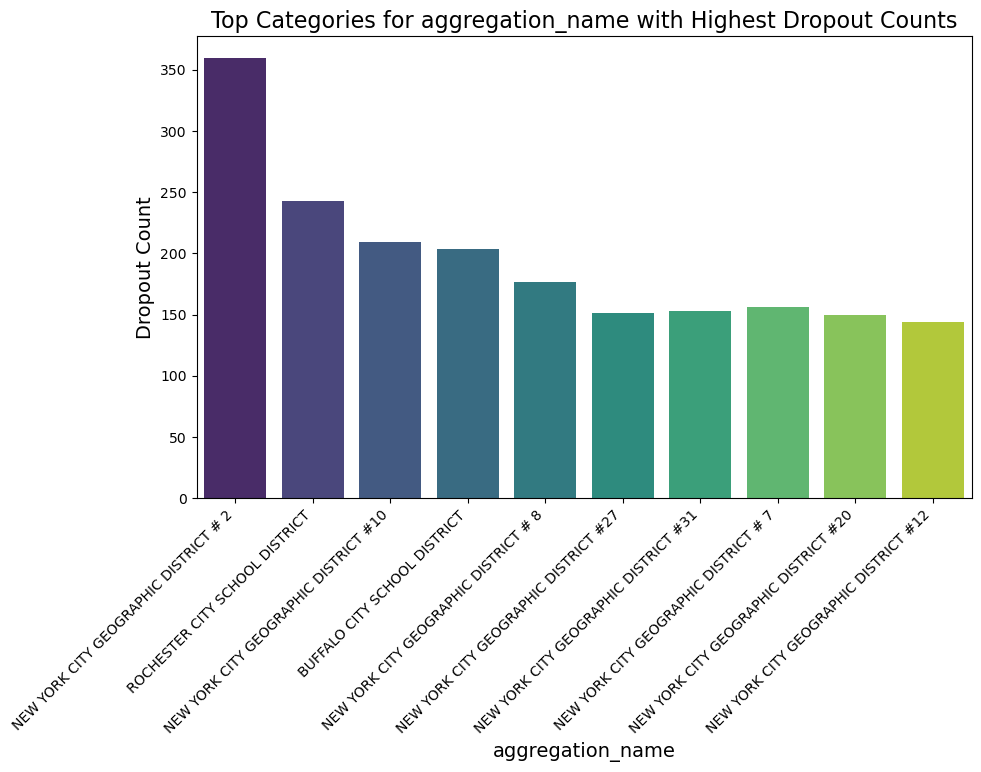

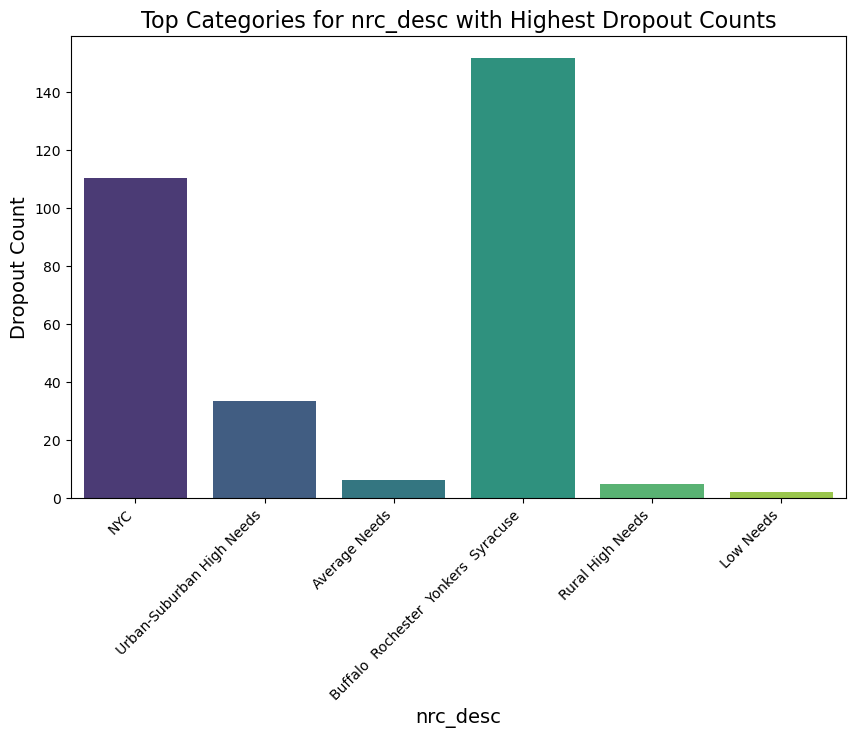

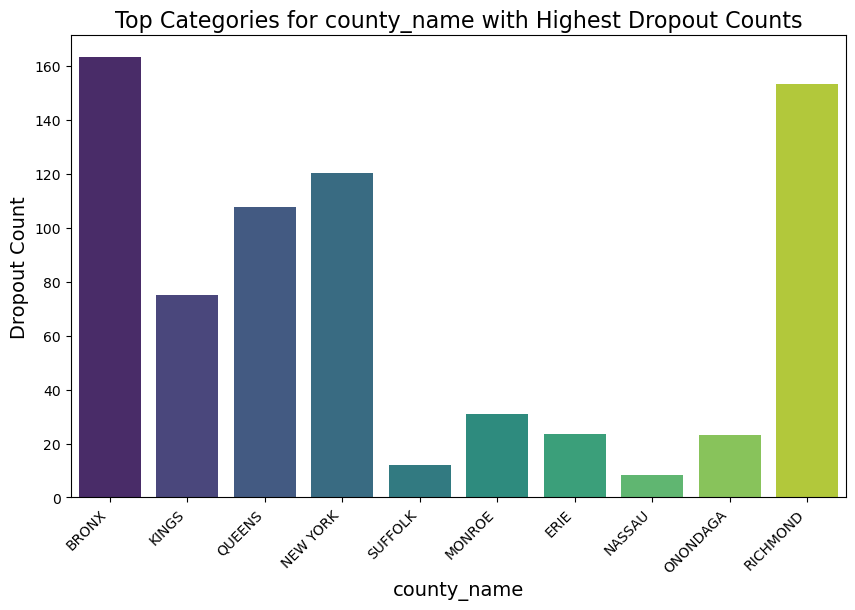

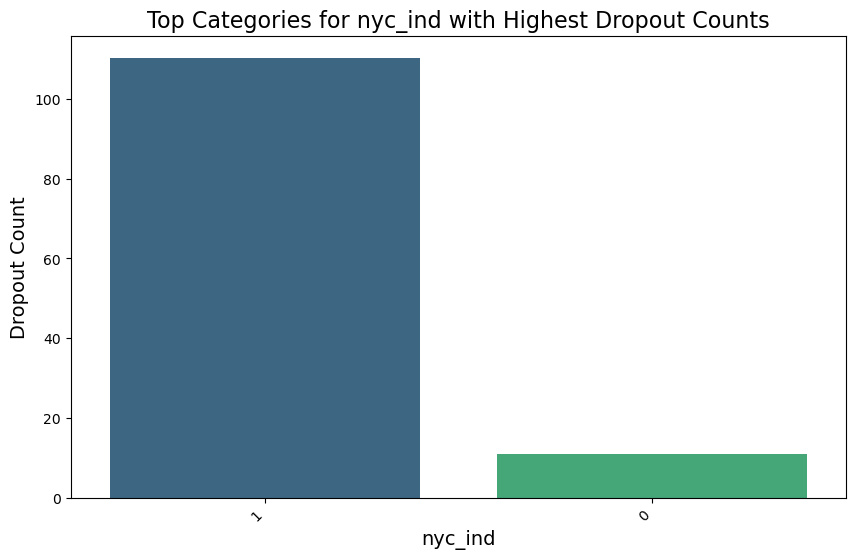

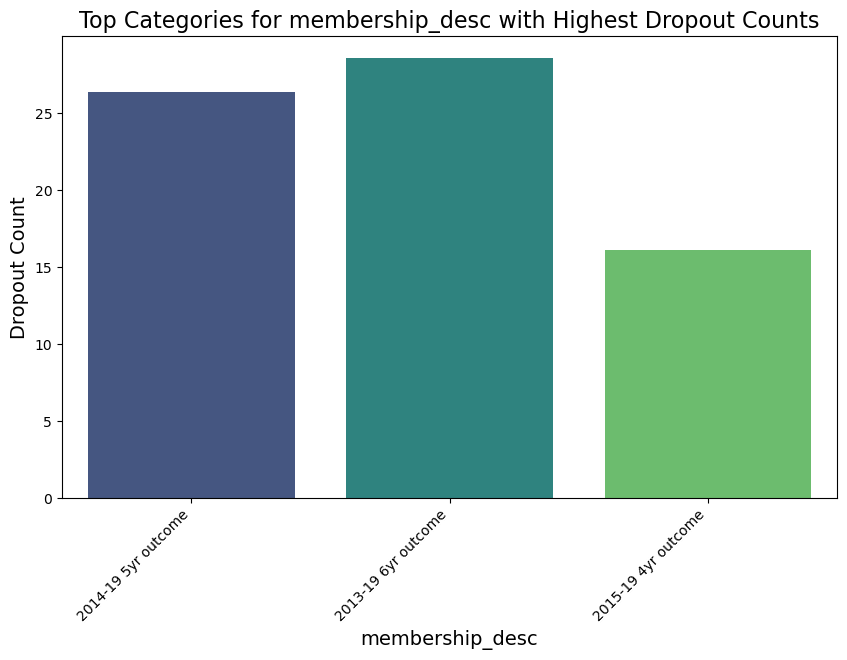

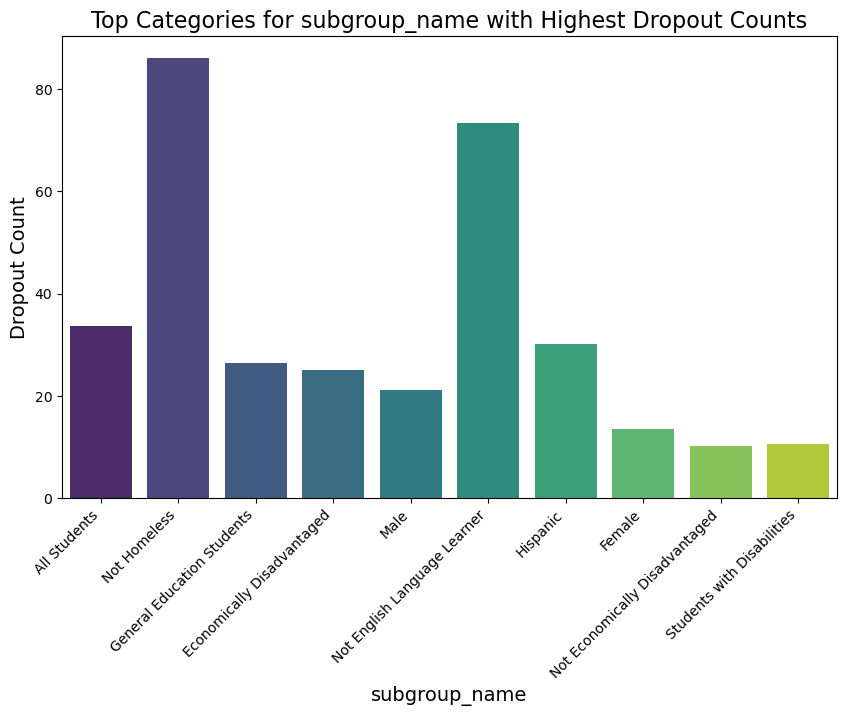

In [30]:
# Define a function which will help us to visualize bivariate analysis plot
def visualize_categorical_dropout_relationship(dataframe, categorical_columns):
    """
    Visualize the relationship between each categorical column and 'dropout_cnt'.

    Parameters:
    - dataframe: DataFrame containing the data
    - categorical_columns: List of categorical columns to visualize

    Returns:
    None (Plots will be displayed)
    """
    for column in categorical_columns:
        # Calculate the top categories with the highest dropout counts
        top_categories = dataframe.groupby(column)['dropout_cnt'].sum().nlargest(10).index

        # Filter the DataFrame for the top categories
        df_top_categories = dataframe[dataframe[column].isin(top_categories)]

        # Bar plot for the categorical column with 'dropout_cnt'
        sns.barplot(x=column, y='dropout_cnt', data=df_top_categories, ci=None, palette='viridis', order=top_categories)
        plt.title(f'Top Categories for {column} with Highest Dropout Counts', fontsize=16)
        plt.xlabel(column, fontsize=14)
        plt.ylabel('Dropout Count', fontsize=14)
        plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
        plt.show()

# Example usage:
categorical_columns = ['aggregation_name', 'nrc_desc', 'county_name', 'nyc_ind', 'membership_desc', 'subgroup_name']
visualize_categorical_dropout_relationship(df_selected_features, categorical_columns)


Fig1: Top 10 dropout school from NYC district.

Fig2: For NRC_desc city school district of NYC has the second highest dropout rate where top most were(Buffalo Rochester Yonkers Syracuse).

Fig3: Based on county name BRONX was the highest dropout county and second highest was Richmond. Suffolk and Nassau had very less dropout count.

Fig4: The number of school district resides outside the borders of NYC was less, so dropout number also less.

Fig5: For membership description as the number of year outcome increase from 4-6 year, the number of dropout students increased accordingly. Less year duration has less dropout rate.

Fig6: Subgroup name "Not Homeless" and "Not English Language Learner" have the highest dropout count compare to others and also Male has more dropout rate than female. In addition to that, the students who are economically advantaged they have less prone to dropout.

## Multivariate Analysis

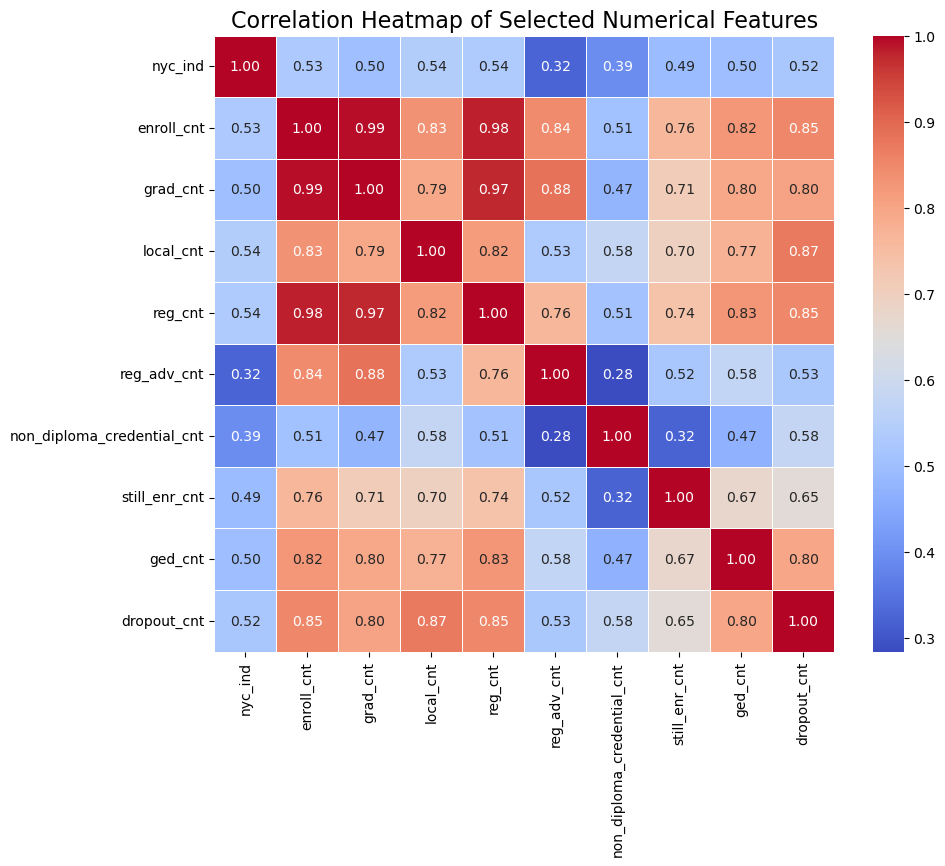

In [31]:
# Calculate the correlation matrix
correlation_matrix = df_selected_features.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))

# Plot the heatmap using seaborn
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)

# Add title to the heatmap
plt.title('Correlation Heatmap of Selected Numerical Features', fontsize=16)

# Display the plot
plt.show();


Observation: We can tell that there are positive correlations among the variables, and we are also particularly interested in identifying possible multi collinearities among explanatory variables, so that we can omit one or more of multi colinear attributes, to avoid noise during our machine learning model.

The correlation matrix gives us more valuable insights about Multicollinearity, Relationship strength with response variable. We can take best feature from here as well which have strong correlation with response variable. 
Enrollment count with Regents diploma count, graduate count are highly correlated each other. 

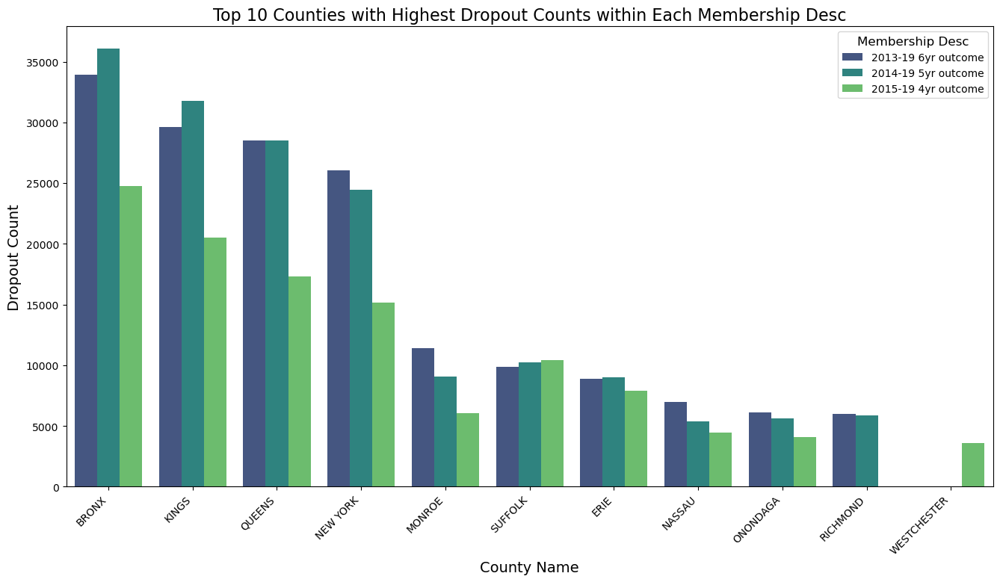

In [32]:
# Calculate the top 10 counties with the highest dropout counts within each membership_desc
top_counties_by_membership = (
    df_selected_features.groupby(['membership_desc', 'county_name'])['dropout_cnt']
    .sum()
    .groupby('membership_desc', group_keys=False)
    .nlargest(10)
    .reset_index()
)

# Bar plot for 'county_name' with 'dropout_cnt' (descending and top 10) within each 'membership_desc'
plt.figure(figsize=(16, 8))
sns.barplot(x='county_name', y='dropout_cnt', hue='membership_desc', data=top_counties_by_membership, palette='viridis')
plt.title('Top 10 Counties with Highest Dropout Counts within Each Membership Desc', fontsize=16)
plt.xlabel('County Name', fontsize=14)
plt.ylabel('Dropout Count', fontsize=14)
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.legend(title='Membership Desc', title_fontsize='12', loc='upper right')
plt.show()


Bronx, Kings, Queens and New York county were the top for dropout numbers. May be their number of students volume higher, more schools availability, people move frequently or can also be other reason. 

In Bronx and kings only 6 yrs outcome has the highest dropout numbers and other counties 5&6 are very close to each other compare to 4 yr outcome.

# Data Preparation

In Data Preparation we will, care about filling missing values, handling outliers mainly as we already removed duplicate values in previous section. 

## Handle Missing Values:

Before transforming the data or dealing with outliers, it's crucial to address missing values.
Use an imputation method to fill in missing values. You mentioned using the K-nearest neighbors (KNN) imputation, so let's proceed with that.

In [33]:
# Check for missing values in each column and sum them up
missing_values = df_selected_features.isna().sum()

# Display the results
print(missing_values)

aggregation_name                  0
nrc_desc                          0
county_name                       0
nyc_ind                           0
membership_desc                   0
subgroup_name                     0
enroll_cnt                    16739
grad_cnt                      16739
local_cnt                     16739
reg_cnt                       16739
reg_adv_cnt                   16739
non_diploma_credential_cnt    16739
still_enr_cnt                 16739
ged_cnt                       16739
dropout_cnt                   16739
year                              0
dtype: int64


### Fill the missing values with K-Nearest Neighbor method

In [34]:
# Create transformers for numerical and categorical columns
numerical_transformer = KNNImputer(n_neighbors=5)

# Apply transformers to numerical and categorical columns
df_selected_features[numeric_columns] = numerical_transformer.fit_transform(df_selected_features[numerical_columns])


In [35]:
# Check for missing values in each column and sum them up
missing_values = df_selected_features.isna().sum()

# Display the results
print(missing_values)

aggregation_name              0
nrc_desc                      0
county_name                   0
nyc_ind                       0
membership_desc               0
subgroup_name                 0
enroll_cnt                    0
grad_cnt                      0
local_cnt                     0
reg_cnt                       0
reg_adv_cnt                   0
non_diploma_credential_cnt    0
still_enr_cnt                 0
ged_cnt                       0
dropout_cnt                   0
year                          0
dtype: int64


Observation: The KNN-Imputer we coded has imputed Missing values across the attributes, hence now all missing values have been addressed. Now we can procced with dealing with outliers and transformation issues.

In [36]:
# Seperate dropout count feature to do standarization for other numeric columns
school_df = df_selected_features.drop("dropout_cnt", axis = 1)

## Apply Box-Cox Transformation:

After addressing missing values we can now apply the Box-Cox transformation before dealing with outliers.

In [37]:
from scipy.stats import boxcox

# Select only numerical columns for Box-Cox transformation
numerical_columns = df_selected_features.select_dtypes(include=np.number).columns

# Apply Box-Cox transformation to each numerical column
for column in numerical_columns:
    # Add 1 to handle zero values
    transformed_data, _ = boxcox(df_selected_features[column] + 1)
    df_selected_features[column] = transformed_data

## Handle Outliers:

Since we have addressed the missing values and the transformation, we now proceed to handle outliers. We shall use Z_score methods to handle outliers.

In [38]:
from scipy.stats import zscore

# Calculate Z-scores for each column 
z_scores = np.abs(zscore(df_selected_features[numerical_columns]))

# Set a threshold for outlier detection (e.g., z_score_threshold = 3)
z_score_threshold = 3
outliers = (z_scores > z_score_threshold).any(axis=1)

# Remove outliers from the DataFrame
df_no_outliers = df_selected_features[~outliers]

Observation: For selecting our Z-Score threshold as 3, we follow a general guideline that considers data points as outliers if they have a Z-Score less than -3 or greater than +3. This guideline is based on the empirical rule in statistics, which states that for a normal distribution, about 68% of the data falls within one standard deviation of the mean. About 95% falls within two standard deviations, about 99.7% within three standard deviations.

# Data Prepped Review

In this section we will display the work done in data preparation and see the difference after cleaning the data. View the data distribution after removing outliers with QQ plot.

### Checking for Outlier Removal

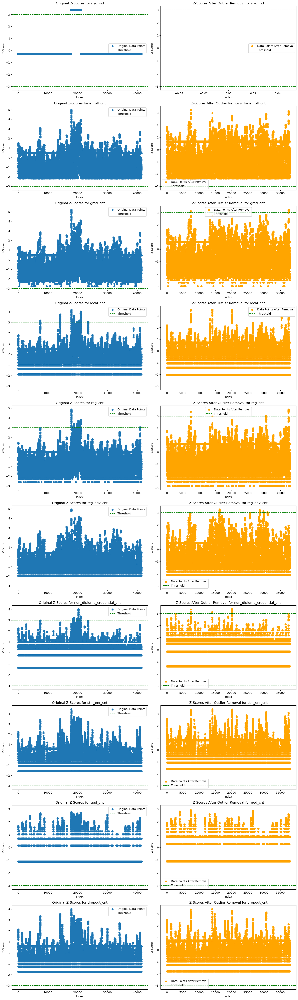

In [39]:
# Calculate Z-scores for each column
z_scores = zscore(df_selected_features[numerical_columns], nan_policy='omit')

# Convert to a NumPy array to simplify indexing
z_scores = np.array(z_scores)

# Set a threshold for outlier detection
z_score_threshold = 3

# Identify outliers (any column with Z-score > threshold)
outliers = np.abs(z_scores) > z_score_threshold

# Remove outliers
df_no_outliers = df_selected_features[~outliers.any(axis=1)]

# Calculate Z-scores again after removing outliers
z_scores_no_outliers = zscore(df_no_outliers[numerical_columns], nan_policy='omit')
z_scores_no_outliers = np.array(z_scores_no_outliers)

# Number of numerical columns
num_columns = len(numerical_columns)

# Setting up the subplot grid for before and after comparison
n_rows = int(np.ceil(num_columns))  # Each row now represents before and after for each column
fig, axs = plt.subplots(n_rows, 2, figsize=(15, n_rows * 5))  # 2 columns for before and after
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, column_name in enumerate(numerical_columns):
    # Original Z-scores column
    z_scores_column = z_scores[:, i]
    # Z-scores column after outlier removal
    z_scores_column_no_outliers = z_scores_no_outliers[:, i]
    
    # Original data plotting
    ax_orig = axs[i, 0]
    ax_orig.scatter(range(len(z_scores_column)), z_scores_column, label='Original Data Points')
    ax_orig.axhline(y=z_score_threshold, color='g', linestyle='--', label='Threshold')
    ax_orig.axhline(y=-z_score_threshold, color='g', linestyle='--')
    ax_orig.set_title(f'Original Z-Scores for {column_name}')
    ax_orig.set_xlabel('Index')
    ax_orig.set_ylabel('Z-Score')
    ax_orig.legend()

    # Data after removing outliers plotting
    ax_no_outliers = axs[i, 1]
    ax_no_outliers.scatter(range(len(z_scores_column_no_outliers)), z_scores_column_no_outliers, label='Data Points After Removal', color='orange')
    ax_no_outliers.axhline(y=z_score_threshold, color='g', linestyle='--', label='Threshold')
    ax_no_outliers.axhline(y=-z_score_threshold, color='g', linestyle='--')
    ax_no_outliers.set_title(f'Z-Scores After Outlier Removal for {column_name}')
    ax_no_outliers.set_xlabel('Index')
    ax_no_outliers.set_ylabel('Z-Score')
    ax_no_outliers.legend()

plt.tight_layout()
plt.show()


Observation: As can be seen with the before removal and after removal graphs, the outliers beyond the Z-Score threshold of 3, have been removed.

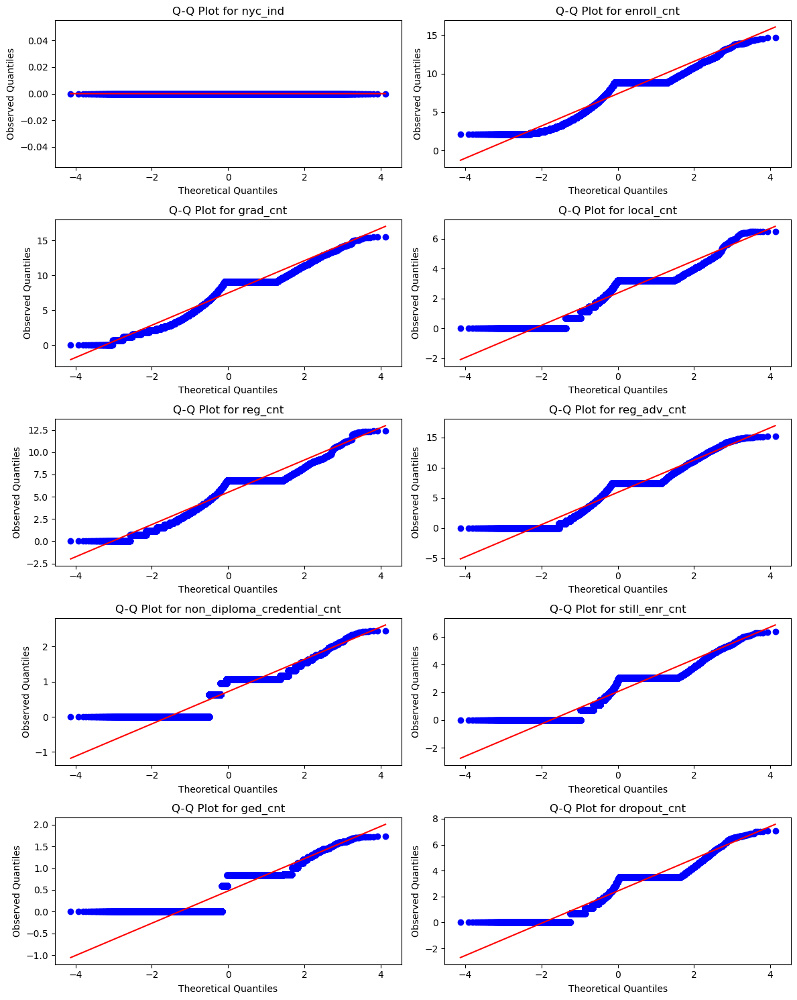

In [40]:
# Call the function with your DataFrame
plot_qq_plots(df_no_outliers)

After outliers handling with box cox method now results much better than earlier but not perfect as we expected.

__Box Plot for numerical variables after data wrangling__

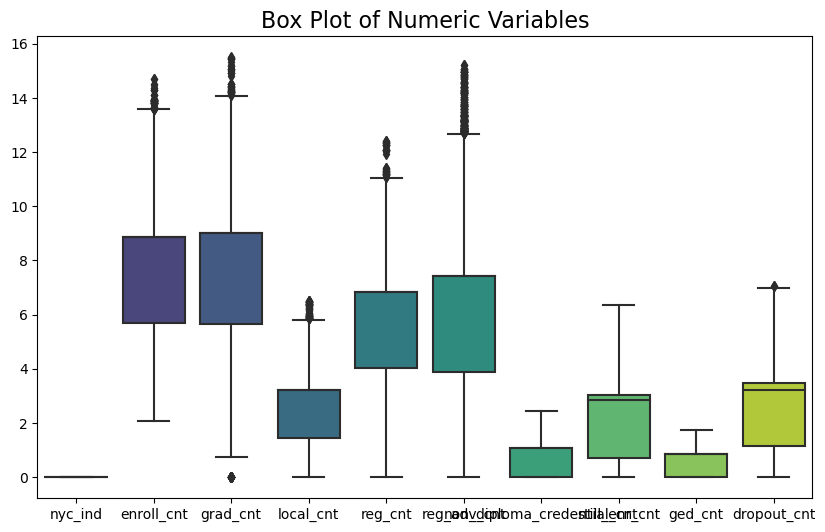

In [41]:
# Select only numerical columns for Box-Cox transformation
numeric_columns1 = df_no_outliers.select_dtypes(include=np.number).columns
# Box plot for each numeric variable
sns.boxplot(data=df_no_outliers[numeric_columns1], palette='viridis')
# Set the title of the plot
plt.title('Box Plot of Numeric Variables', fontsize=16)

# Display the plot
plt.show();

__Plot after removing outliers__

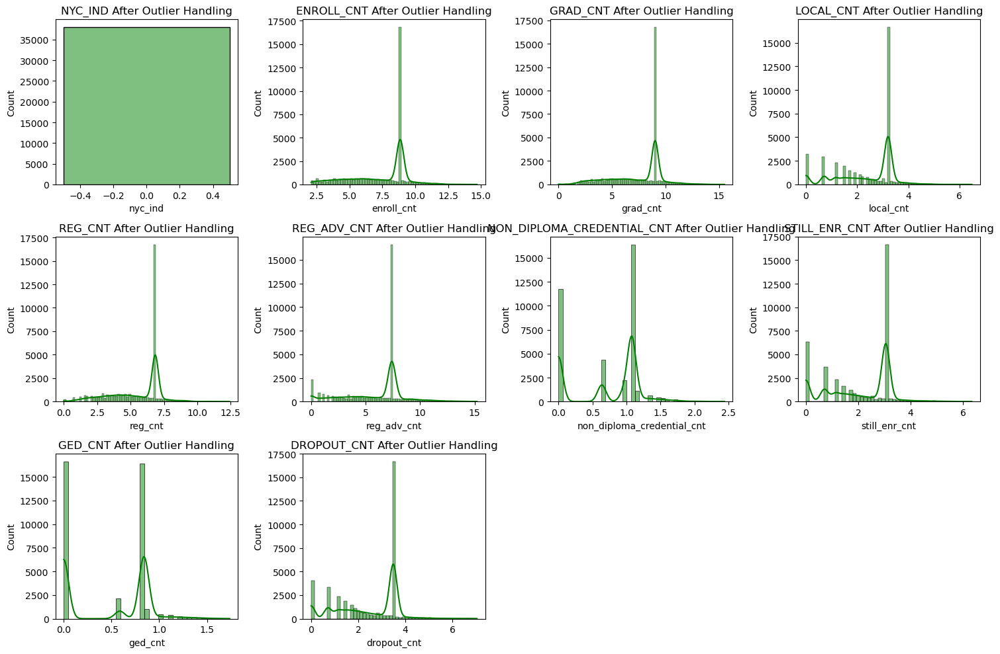

In [42]:
# Create histograms for selected columns after outlier handling
plt.figure(figsize=(15,10))  # Set the overall size of the subplot grid

# Loop through the selected columns to create individual histograms
for i, column in enumerate(df_no_outliers[numeric_columns1], 1):
    plt.subplot(3, 4, i)  # Create subplots in a 4x4 grid
    sns.histplot(df_no_outliers[column], kde=True, color="green")  # Plot histogram with KDE
    plt.title(f"{column.upper()} After Outlier Handling")  # Set the title of each subplot to the column name

plt.tight_layout()  # Adjust layout to prevent overlap of subplots
plt.show()  # Display the plot

After outlier handling we have found better result for our data distribution.

### Convert categorical features into numerical ( One hot Encoding )

In [43]:
# One-hot encode categorical variables
df_no_outliers = pd.get_dummies(df_no_outliers, columns=['aggregation_name', 'nrc_desc', 'county_name', 'membership_desc', 
                                                         'subgroup_name'])

In [44]:
df_no_outliers.head()

,nyc_ind,enroll_cnt,grad_cnt,local_cnt,reg_cnt,reg_adv_cnt,non_diploma_credential_cnt,still_enr_cnt,ged_cnt,dropout_cnt,...,subgroup_name_Multiracial,subgroup_name_Not Economically Disadvantaged,subgroup_name_Not English Language Learner,subgroup_name_Not Homeless,subgroup_name_Not Migrant,subgroup_name_Not in Foster Care,subgroup_name_Parent Not in Armed Forces,subgroup_name_Parent in Armed Forces,subgroup_name_Students with Disabilities,subgroup_name_White
0,0.0,11.338090,11.311191,4.884972,8.925878,7.968336,2.031054,3.679885,0.000000,5.793489,...,0,0,0,0,0,0,0,0,0,0
1,0.0,9.468151,9.483094,3.919650,7.603933,6.253604,0.960850,2.612022,0.000000,4.734238,...,0,0,0,0,0,0,0,0,0,0
2,0.0,9.544094,9.158632,4.039747,7.231758,6.097117,1.968373,3.181762,0.000000,5.042823,...,0,0,0,0,0,0,0,0,0,0
3,0.0,8.851066,9.025619,3.208425,6.849376,7.407776,1.075434,3.049791,0.839641,3.485370,...,0,0,0,0,0,0,0,0,0,0
4,0.0,9.781863,9.505098,4.348862,7.770664,4.688834,1.804342,3.124028,0.000000,5.160338,...,0,0,0,0,0,0,0,0,0,0


### Standardization

Standardizing the dataset (also known as z-score normalization) before splitting it into training and testing sets is a good practice. It helps ensure that the features have similar scales, which can be beneficial for certain machine learning algorithms. To that valid reason we will standardize our dataset before splitting it into training and testing sets using scikit-learn.

In [45]:
# Declare the variable as scaler 
scaler = StandardScaler()

# Extract the numerical columns for standardization
numerical_columns = df_no_outliers.columns

# Fit and transform the data using the scaler
df_no_outliers[numerical_columns] = scaler.fit_transform(df_no_outliers[numerical_columns])


In [46]:
# Add dropout count variable to the cleaned dataframe for further work process 
df_no_outliers['dropout_cnt'] = df_selected_features["dropout_cnt"]

# Model Building
To fit the data into the model we need to split the data as train test first. Then Feature selection, dimensionality reduction and model building.

__Split data into features and target variable__

In [47]:
# Split data into features and target variable
X = df_no_outliers.drop('dropout_cnt', axis=1)
y = df_no_outliers['dropout_cnt']
# Split data into training and evaluation sets
X_train, X_eval, y_train, y_eval = train_test_split(X, y, test_size=0.2, random_state=42)

__Feature Selection and Dimensionality Reduction__

In [48]:
# Using SelectKBest for feature selection
feature_selector = SelectKBest(score_func=f_regression, k=5)
X_train_selected = feature_selector.fit_transform(X_train, y_train)

In [49]:
# Using PCA for dimensionality reduction
pca = PCA(n_components=5)
X_train_pca = pca.fit_transform(X_train)


__Check Target Variable Distribution:__
Ensure that the target variable (y_train) has a valid distribution for Poisson regression. Poisson regression assumes a Poisson distribution of the target variable, so it should contain non-negative integer values. You can visualize the distribution using a histogram.

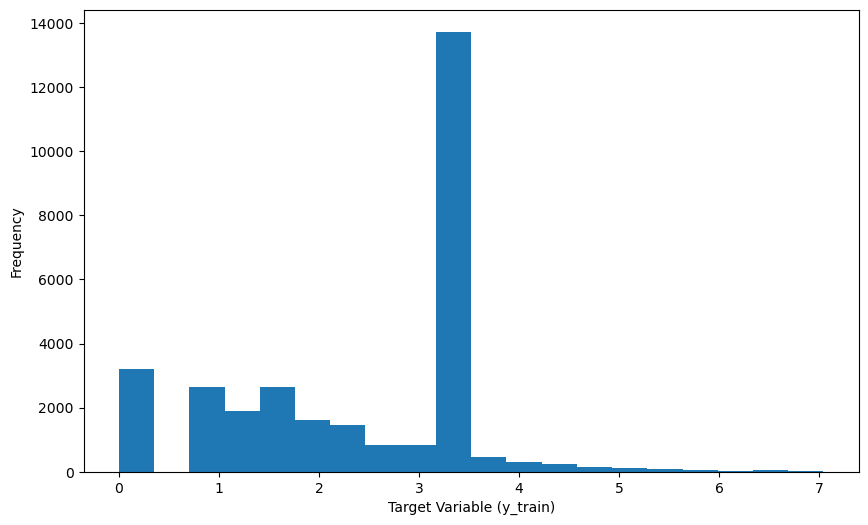

In [50]:
plt.hist(y_train, bins=20)
plt.xlabel("Target Variable (y_train)")
plt.ylabel("Frequency")
plt.show()

__Check for Outliers:__
Examine our target variable for outliers that might be affecting the estimation process.

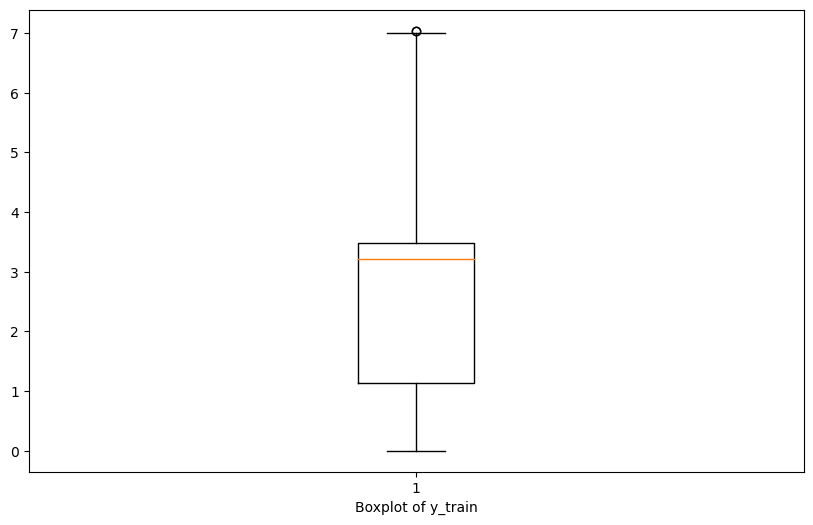

In [51]:
plt.boxplot(y_train)
plt.xlabel("Boxplot of y_train")
plt.show()

__Linear Regression:__
If response variable is continuous and can take negative values, linear regression might be a suitable option. It does not have the non-negativity assumption of Poisson regression.

__Model Building : Poisson Regression__

In [52]:
# Construct Poisson regression models
poisson_model_1 = sm.GLM(y_train, sm.add_constant(X_train_selected), family=sm.families.Poisson()).fit()
poisson_model_2 = sm.GLM(y_train, sm.add_constant(X_train_pca), family=sm.families.Poisson()).fit()

In [53]:
poisson_model_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:                 Poisson   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -42919.
Date:                Sun, 25 Feb 2024   Deviance:                       9788.8
Time:                        20:23:45   Pearson chi2:                 6.68e+03
No. Iterations:                     5   Pseudo R-squ. (CS):             0.4969
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7315      0.004    171.192      0.000       0.723       0.740
x1             1.4848      0.033     44.616      0.000       1.420       1.550
x2            -1.5387      0.032    -48.635      0.000      -1.601      -1.477
x3             0.1770      0.008     22.834      0.000       0.162       0.192
x4             0.4737      0.018     26.908      0.000       0.439       0.508
x5            -0.0388      0.008     -4.710      0.000      -0.055      -0.023
==============================================================================
"""

In [54]:
poisson_model_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:                 Poisson   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -43864.
Date:                Sun, 25 Feb 2024   Deviance:                       11677.
Time:                        20:23:45   Pearson chi2:                 8.94e+03
No. Iterations:                     5   Pseudo R-squ. (CS):             0.4647
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7442      0.004    175.278      0.000       0.736       0.752
x1             0.2145      0.002    124.235      0.000       0.211       0.218
x2            -0.0622      0.002    -28.074      0.000      -0.067      -0.058
x3            -0.0053      0.002     -2.464      0.014      -0.009      -0.001
x4            -0.0030      0.002     -1.291      0.197      -0.007       0.002
x5             0.0422      0.002     19.049      0.000       0.038       0.047
==============================================================================
"""

__Model Building : Negative Binomial Regression__

In [55]:
# Construct Negative Binomial models
neg_binom_model_1 = sm.GLM(y_train, sm.add_constant(X_train_selected), family=sm.families.NegativeBinomial(alpha = 2)).fit()
neg_binom_model_2 = sm.GLM(y_train, sm.add_constant(X_train_pca), family=sm.families.NegativeBinomial(alpha=2)).fit()

In [56]:
neg_binom_model_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:        NegativeBinomial   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -67445.
Date:                Sun, 25 Feb 2024   Deviance:                       3653.3
Time:                        20:23:45   Pearson chi2:                 1.84e+03
No. Iterations:                    19   Pseudo R-squ. (CS):             0.1459
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.6856      0.009     73.134      0.000       0.667       0.704
x1             3.3221      0.097     34.107      0.000       3.131       3.513
x2            -3.2006      0.091    -35.343      0.000      -3.378      -3.023
x3             0.1630      0.018      9.140      0.000       0.128       0.198
x4             0.5358      0.038     13.952      0.000       0.461       0.611
x5            -0.1961      0.020     -9.728      0.000      -0.236      -0.157
==============================================================================
"""

In [57]:
neg_binom_model_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:        NegativeBinomial   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -67861.
Date:                Sun, 25 Feb 2024   Deviance:                       4486.4
Time:                        20:23:45   Pearson chi2:                 2.67e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.1221
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7244      0.009     78.410      0.000       0.706       0.742
x1             0.2393      0.004     63.867      0.000       0.232       0.247
x2            -0.0796      0.005    -15.038      0.000      -0.090      -0.069
x3            -0.0011      0.005     -0.212      0.832      -0.011       0.009
x4            -0.0003      0.006     -0.057      0.954      -0.012       0.011
x5             0.0600      0.006     10.302      0.000       0.049       0.071
==============================================================================
"""

__Model Building : Linear Regression__

In [58]:
# Construct Multiple Linear Regression models
linear_model_1 = LinearRegression().fit(X_train_selected, y_train)
linear_model_2 = LinearRegression().fit(X_train_pca, y_train)

# Model Evaluation and Selection

In [59]:
# Evaluate models on the evaluation set
X_eval_selected = feature_selector.transform(X_eval)
X_eval_pca = pca.transform(X_eval)

##  Predictions for Poisson models

In [60]:
# Predictions for Poisson models
poisson_pred_1 = poisson_model_1.predict(sm.add_constant(X_eval_selected))
poisson_pred_2 = poisson_model_2.predict(sm.add_constant(X_eval_pca))

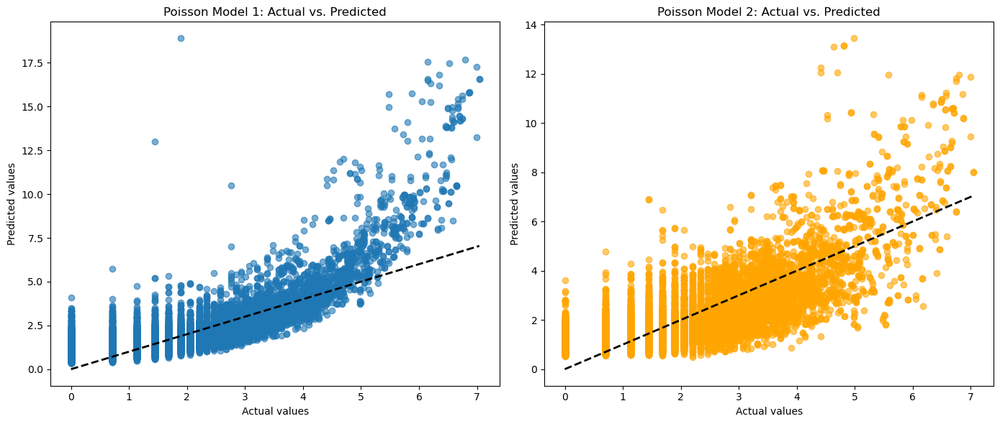

In [61]:
#POISON:
# Predictions on training data for both Poisson models
poisson_pred_1_train = poisson_model_1.predict(sm.add_constant(X_train_selected))
poisson_pred_2_train = poisson_model_2.predict(sm.add_constant(X_train_pca))

# Scatter plot for Poisson Model 1
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_train, poisson_pred_1_train, alpha=0.6)
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Poisson Model 1: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

# Scatter plot for Poisson Model 2
plt.subplot(1, 2, 2)
plt.scatter(y_train, poisson_pred_2_train, alpha=0.6, color='orange')
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Poisson Model 2: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.tight_layout()
plt.show()

The prediction for both Poisson Regression before and after PCA have a bit difference where after PCA model works better than without PCA. Model 2 in our case was better performance.   

## Predictions for Negative Binomial models

In [62]:
# Predictions for Negative Binomial models
neg_binom_pred_1 = neg_binom_model_1.predict(sm.add_constant(X_eval_selected))
neg_binom_pred_2 = neg_binom_model_2.predict(sm.add_constant(X_eval_pca))

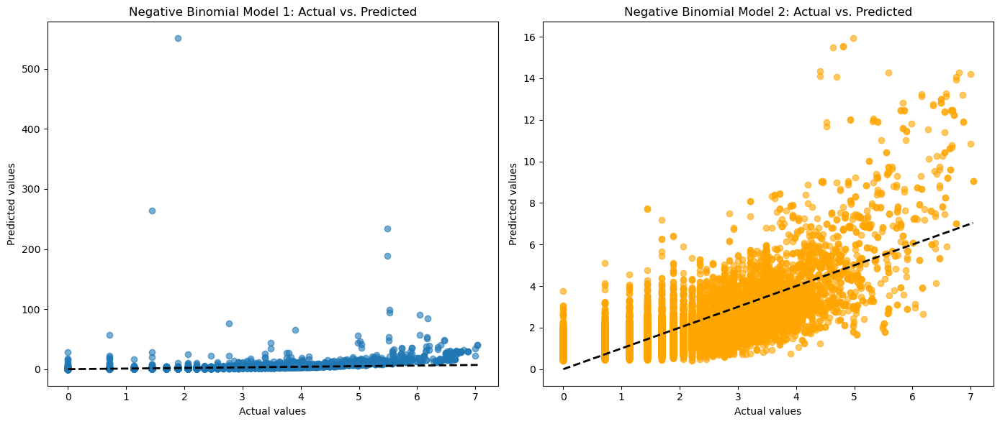

In [63]:
# NEGATIVE BINOMIAL
# Predictions on training data for both Negative Binomial models
neg_binom_pred_1_train = neg_binom_model_1.predict(sm.add_constant(X_train_selected))
neg_binom_pred_2_train = neg_binom_model_2.predict(sm.add_constant(X_train_pca))

# Scatter plot for Negative Binomial Model 1
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_train, neg_binom_pred_1_train, alpha=0.6)
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Negative Binomial Model 1: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

# Scatter plot for Negative Binomial Model 2
plt.subplot(1, 2, 2)
plt.scatter(y_train, neg_binom_pred_2_train, alpha=0.6, color='orange')
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Negative Binomial Model 2: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.tight_layout()
plt.show()

For Negative Binomial regression model with PCA works better than without PCA data model. The prediction line fits well for PCA data model.

## Predictions for Multiple Linear Regression models

In [64]:
# Predictions for Multiple Linear Regression models
linear_pred_1 = linear_model_1.predict(X_eval_selected)
linear_pred_2 = linear_model_2.predict(X_eval_pca)

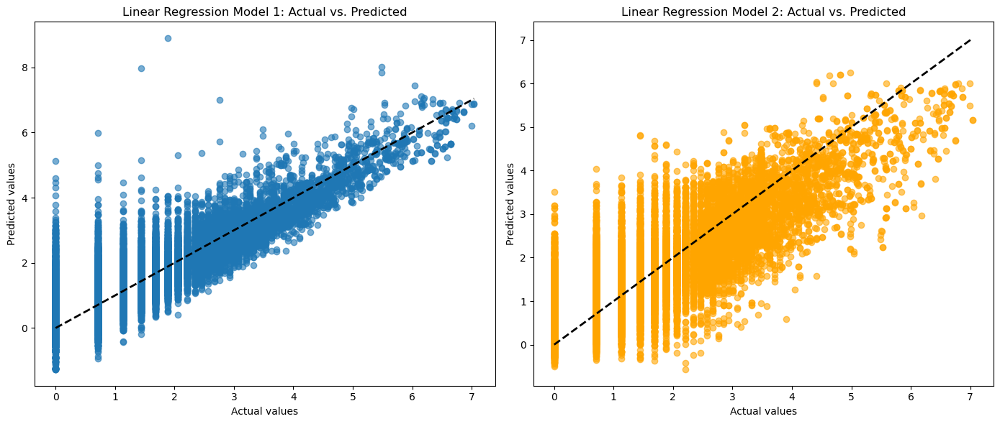

In [65]:
# Predictions on training data for both Linear Regression models
linear_pred_1_train = linear_model_1.predict(X_train_selected)
linear_pred_2_train = linear_model_2.predict(X_train_pca)

# Scatter plot for Linear Regression Model 1
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_train, linear_pred_1_train, alpha=0.6)
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Linear Regression Model 1: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

# Scatter plot for Linear Regression Model 2
plt.subplot(1, 2, 2)
plt.scatter(y_train, linear_pred_2_train, alpha=0.6, color='orange')
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2) # Diagonal line for reference
plt.title('Linear Regression Model 2: Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.tight_layout()
plt.show()

Linear Regression model without PCA performing better than with PCA model. We can see the data points are close to the predicted line and positively upward moving right direction. 

## Residual Plots

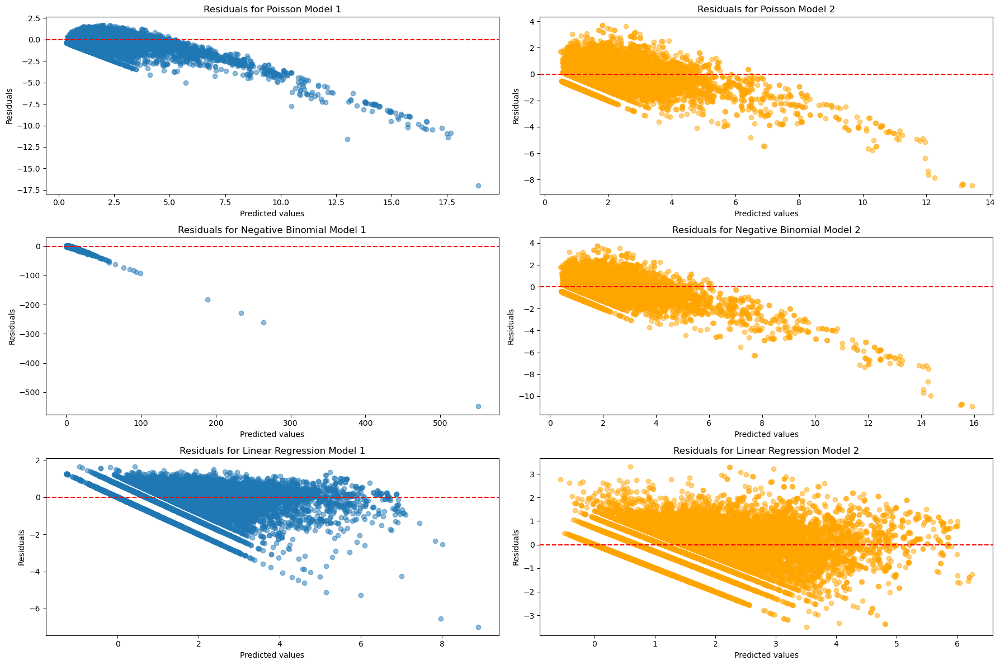

In [66]:
# Calculate residuals for each model
residuals_poisson_1 = y_train - poisson_pred_1_train
residuals_poisson_2 = y_train - poisson_pred_2_train
residuals_neg_binom_1 = y_train - neg_binom_pred_1_train
residuals_neg_binom_2 = y_train - neg_binom_pred_2_train
residuals_linear_1 = y_train - linear_pred_1_train
residuals_linear_2 = y_train - linear_pred_2_train

# Plotting the residual plots
plt.figure(figsize=(18, 12))

# Residual plot for Poisson Model 1
plt.subplot(3, 2, 1)
plt.scatter(poisson_pred_1_train, residuals_poisson_1, alpha=0.5)
plt.title('Residuals for Poisson Model 1')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

# Residual plot for Poisson Model 2
plt.subplot(3, 2, 2)
plt.scatter(poisson_pred_2_train, residuals_poisson_2, alpha=0.5, color='orange')
plt.title('Residuals for Poisson Model 2')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

# Residual plot for Negative Binomial Model 1
plt.subplot(3, 2, 3)
plt.scatter(neg_binom_pred_1_train, residuals_neg_binom_1, alpha=0.5)
plt.title('Residuals for Negative Binomial Model 1')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

# Residual plot for Negative Binomial Model 2
plt.subplot(3, 2, 4)
plt.scatter(neg_binom_pred_2_train, residuals_neg_binom_2, alpha=0.5, color='orange')
plt.title('Residuals for Negative Binomial Model 2')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

# Residual plot for Linear Regression Model 1
plt.subplot(3, 2, 5)
plt.scatter(linear_pred_1_train, residuals_linear_1, alpha=0.5)
plt.title('Residuals for Linear Regression Model 1')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

# Residual plot for Linear Regression Model 2
plt.subplot(3, 2, 6)
plt.scatter(linear_pred_2_train, residuals_linear_2, alpha=0.5, color='orange')
plt.title('Residuals for Linear Regression Model 2')
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')

plt.tight_layout()
plt.show();

Residual plots for Linear model shows better data distribution than all those 4 other models. They seems to be normal distribution. 

## Calculate mean squared error for evaluation

In [67]:
# Calculate mean squared error for evaluation
mse_poisson_1 = mean_squared_error(y_eval, poisson_pred_1)
mse_poisson_2 = mean_squared_error(y_eval, poisson_pred_2)

mse_neg_binom_1 = mean_squared_error(y_eval, neg_binom_pred_1)
mse_neg_binom_2 = mean_squared_error(y_eval, neg_binom_pred_2)

mse_linear_1 = mean_squared_error(y_eval, linear_pred_1)
mse_linear_2 = mean_squared_error(y_eval, linear_pred_2 )


In [68]:
# Calculate RMSE for evaluation
rmse_poisson_1 = mean_squared_error(y_eval, poisson_pred_1, squared=False)
rmse_poisson_2 = mean_squared_error(y_eval, poisson_pred_2, squared=False)

rmse_neg_binom_1 = mean_squared_error(y_eval, neg_binom_pred_1, squared=False)
rmse_neg_binom_2 = mean_squared_error(y_eval, neg_binom_pred_2, squared=False)

rmse_linear_1 = mean_squared_error(y_eval, linear_pred_1, squared=False)
rmse_linear_2 = mean_squared_error(y_eval, linear_pred_2, squared=False)

In [69]:
# Calculate MAE for Evaluation
mae_poisson_1 = mean_absolute_error(y_eval, poisson_pred_1)
mae_poisson_2 = mean_absolute_error(y_eval, poisson_pred_2)

mae_neg_binom_1 = mean_absolute_error(y_eval, neg_binom_pred_1)
mae_neg_binom_2 = mean_absolute_error(y_eval, neg_binom_pred_2)

mae_linear_1 = mean_absolute_error(y_eval, linear_pred_1)
mae_linear_2 = mean_absolute_error(y_eval, linear_pred_2)

# Model Selection

## Select the model with the lowest mean squared error

In [70]:
# Creating a DataFrame
data = {
    'Model': ['Poisson_1', 'Poisson_2', 'Neg_Binom_1', 'Neg_Binom_2', 'Linear_1', 'Linear_2'],
    'MSE': [mse_poisson_1, mse_poisson_2, mse_neg_binom_1, mse_neg_binom_2, mse_linear_1, mse_linear_2],
    'RMSE': [rmse_poisson_1, rmse_poisson_2, rmse_neg_binom_1, rmse_neg_binom_2, rmse_linear_1, rmse_linear_2],
    'MAE': [mae_poisson_1, mae_poisson_2, mae_neg_binom_1, mae_neg_binom_2, mae_linear_1, mae_linear_2]
}

df = pd.DataFrame(data)

# Print the DataFrame
df

,Model,MSE,RMSE,MAE
0,Poisson_1,0.593706,0.770523,0.482260
1,Poisson_2,0.541955,0.736176,0.532333
2,Neg_Binom_1,65.675840,8.104063,0.737029
3,Neg_Binom_2,0.649810,0.806108,0.571767
4,Linear_1,0.321629,0.567123,0.370561
5,Linear_2,0.429211,0.655142,0.467710


In [71]:
# Creating a DataFrame
data = {
    'Model': ['Poisson_1', 'Poisson_2', 'Neg_Binom_1', 'Neg_Binom_2', 'Linear_1', 'Linear_2'],
    'MSE': [mse_poisson_1, mse_poisson_2, mse_neg_binom_1, mse_neg_binom_2, mse_linear_1, mse_linear_2],
    'RMSE': [rmse_poisson_1, rmse_poisson_2, rmse_neg_binom_1, rmse_neg_binom_2, rmse_linear_1, rmse_linear_2],
    'MAE': [mae_poisson_1, mae_poisson_2, mae_neg_binom_1, mae_neg_binom_2, mae_linear_1, mae_linear_2]
}

df = pd.DataFrame(data)

# Finding the best results
best_results = {
    'Best MSE': df.loc[df['MSE'].idxmin()],
    'Best RMSE': df.loc[df['RMSE'].idxmin()],
    'Best MAE': df.loc[df['MAE'].idxmin()]
}

# Creating a DataFrame for the best results
best_results_df = pd.DataFrame(best_results)

# Print the best results
best_results_df


,Best MSE,Best RMSE,Best MAE
Model,Linear_1,Linear_1,Linear_1
MSE,0.321629,0.321629,0.321629
RMSE,0.567123,0.567123,0.567123
MAE,0.370561,0.370561,0.370561


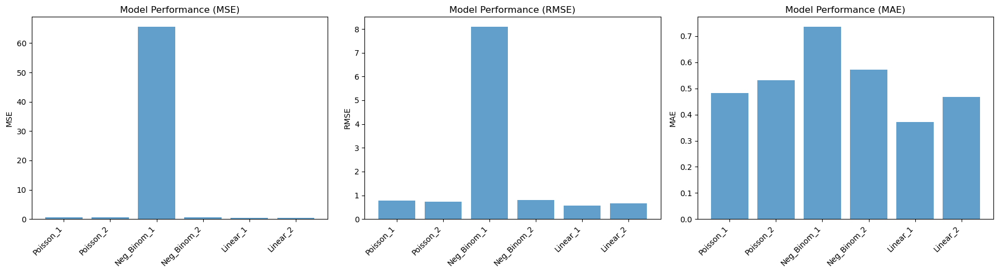

In [72]:
# Data for plotting
models = ['Poisson_1', 'Poisson_2', 'Neg_Binom_1', 'Neg_Binom_2', 'Linear_1', 'Linear_2']
mse = [mse_poisson_1, mse_poisson_2, mse_neg_binom_1, mse_neg_binom_2, mse_linear_1, mse_linear_2]
rmse = [rmse_poisson_1, rmse_poisson_2, rmse_neg_binom_1, rmse_neg_binom_2, rmse_linear_1, rmse_linear_2]
mae = [mae_poisson_1, mae_poisson_2, mae_neg_binom_1, mae_neg_binom_2, mae_linear_1, mae_linear_2]

# Function to plot the performance
def plot_model_performance(models, scores, score_name):
    y_pos = np.arange(len(models))
    plt.bar(y_pos, scores, align='center', alpha=0.7)
    plt.xticks(y_pos, models, rotation=45, ha="right")
    plt.ylabel(score_name)
    plt.title(f'Model Performance ({score_name})')

plt.figure(figsize=(18, 5))

# Plot MSE
plt.subplot(1, 3, 1)
plot_model_performance(models, mse, 'MSE')

# Plot RMSE
plt.subplot(1, 3, 2)
plot_model_performance(models, rmse, 'RMSE')

# Plot MAE
plt.subplot(1, 3, 3)
plot_model_performance(models, mae, 'MAE')

plt.tight_layout()
plt.show();


## Compute SHAP Values

SHAp plot is not working with GLM model, so We used XG boost regression to show the features predictability for target variable. We will show few plots to explain the SHAP ability to show us the important features effect on model predictability.

In [73]:
# Train an XGBoost model with small trees
xgb_model = xgb.XGBRegressor(max_depth=3, n_estimators=100)
xgb_model.fit(X_train, y_train)

# Create a Shapley explainer for the XGBoost model
explainer_xgb = shap.Explainer(xgb_model)

# Get Shapley values for the evaluation data
shap_values_xgb = explainer_xgb.shap_values(X_eval)


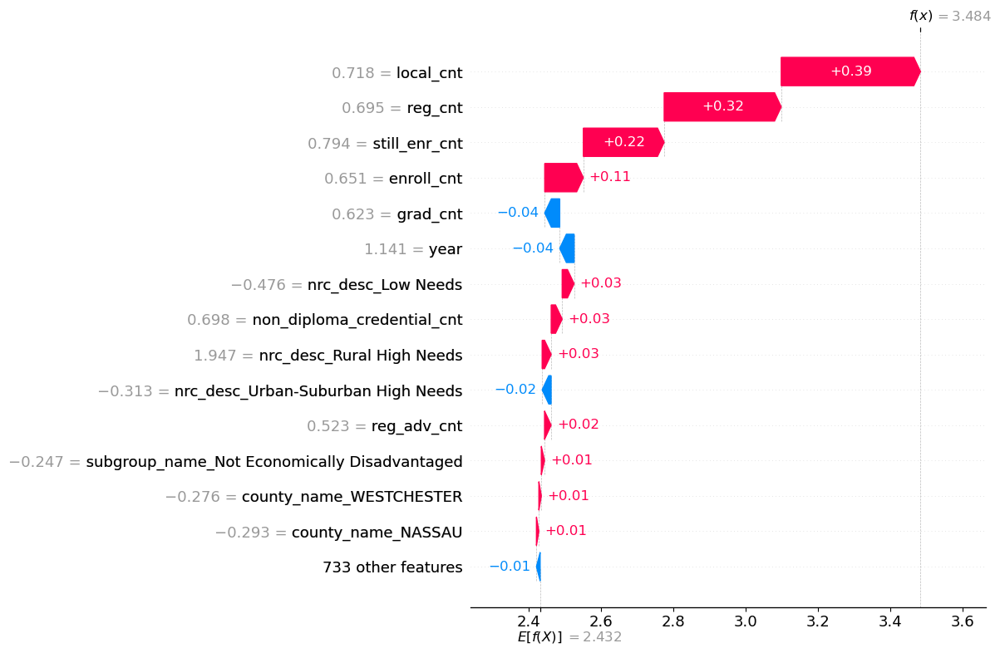

In [74]:
# Plot the waterfall chart for a specific instance (change index as needed)
shap.waterfall_plot(shap.Explanation(values=shap_values_xgb[0], base_values=explainer_xgb.expected_value, data=X_eval.iloc[0]), max_display=15)

# Show the plot
plt.show()

From the waterfall chart we can see red values  local count, regent count, still enrollment count which have higher predictability power for dropout count and lowest in year, graduate count which in blue color. 

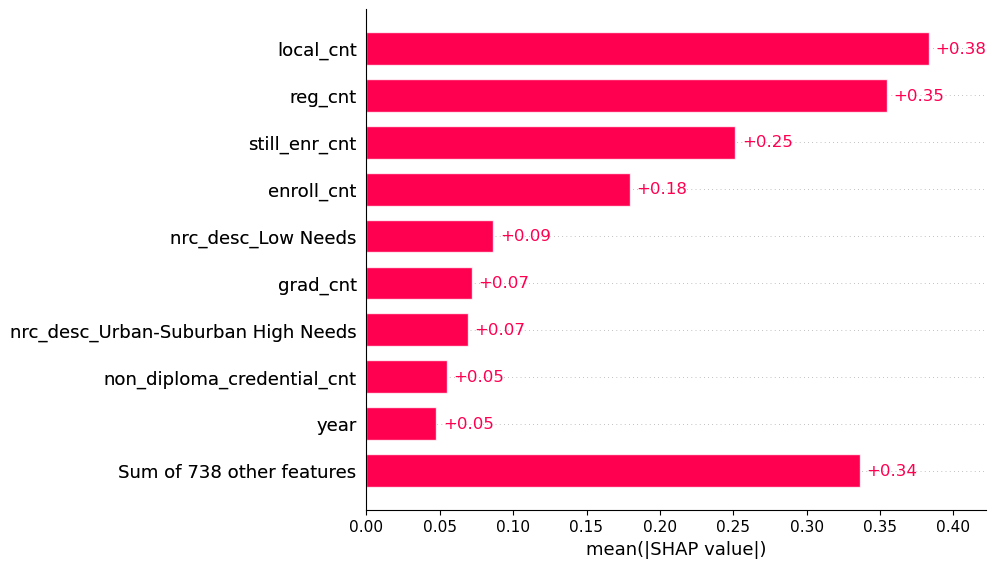

In [75]:
# Create an Explanation object
shap_values_explanation = shap.Explanation(values=shap_values_xgb, base_values=explainer_xgb.expected_value, data=X_eval, feature_names=X_eval.columns)

# Plot the bar plot for Shapley values
shap.plots.bar(shap_values_explanation, max_display=10, show=False)
plt.gcf()

# Show the plot if needed
plt.show()

Most dominant features are local count, regent count, still enrollment count contribution highest for dropout count prediction.

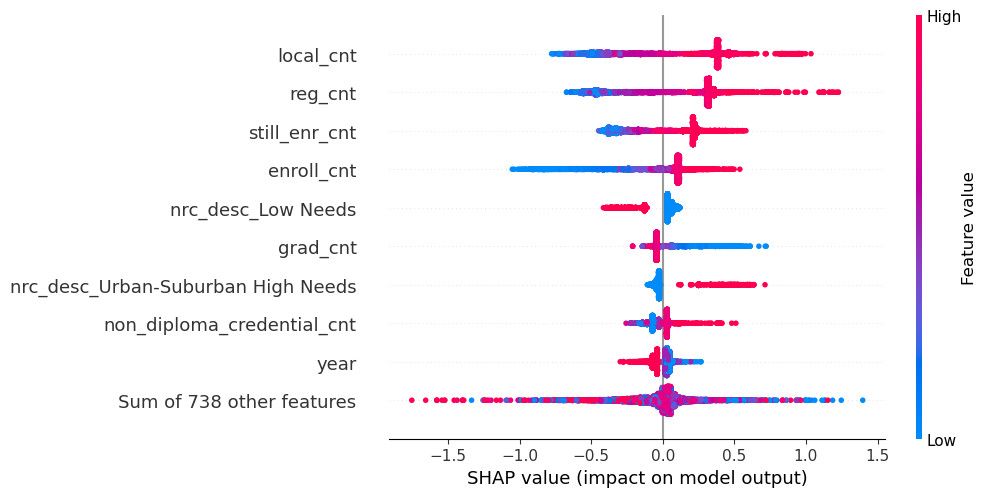

In [76]:
# Plot the bar plot for Shapley values
shap.plots.beeswarm(shap_values_explanation, max_display=10, show=False)
plt.gcf()

# Show the plot if needed
plt.show()

The value of local count, regent diploma count, still enrollment count for dropout count variable are relatively high, so it appears as red dot and relatively low variable values appear as blue color dot , for example, graduate count.

## Optional: Check coefficients and statistical significance using statsmodels

In [77]:
# Optional: Check coefficients and statistical significance using statsmodels
X_train_with_intercept = sm.add_constant(X_train_selected)
poisson_model_sm = sm.GLM(y_train, X_train_with_intercept, family=sm.families.Poisson()).fit()
print(poisson_model_sm.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:                 Poisson   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -42919.
Date:                Sun, 25 Feb 2024   Deviance:                       9788.8
Time:                        20:23:54   Pearson chi2:                 6.68e+03
No. Iterations:                     5   Pseudo R-squ. (CS):             0.4969
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7315      0.004    171.192      0.0

In [78]:
X_train_with_intercept = sm.add_constant(X_train_pca)
poisson_model_sm = sm.GLM(y_train, X_train_with_intercept, family=sm.families.Poisson()).fit()
print(poisson_model_sm.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:            dropout_cnt   No. Observations:                30390
Model:                            GLM   Df Residuals:                    30384
Model Family:                 Poisson   Df Model:                            5
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -43864.
Date:                Sun, 25 Feb 2024   Deviance:                       11677.
Time:                        20:23:54   Pearson chi2:                 8.94e+03
No. Iterations:                     5   Pseudo R-squ. (CS):             0.4647
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7442      0.004    175.278      0.0

# Conclusion


In this project, we embarked on a comprehensive journey through the data science lifecycle, focusing on implementing and evaluating a series of regression models to predict dropout counts in NY State High Schools based on various characteristics. The dataset provided offered a deep dive into the graduation metrics for the 2018-2019 school year, sourced from the NY State Education Department. It included over 73,000 observations with 29 attributes, requiring a detailed exploration and preparation phase to ensure the data was fit for analysis.

During the exploratory data analysis (EDA) phase, we utilized visualization and statistical methods to understand the dataset's structure, identify patterns, and detect outliers and anomalies. This phase was crucial for identifying the relationships between variables and the overall distribution of the data. We meticulously prepared the data, converting categorical variables into a numerical format, addressing missing values with KNN imputation, and handling outliers through statistical methods. The preprocessing steps also involved standardizing the dataset to ensure a fair comparison between variables during the modeling phase.

For the regression modeling, we selected models based on their appropriateness for the data and the prediction task. The models included Linear Regression, Poisson Regression, and an exploration of Negative Binomial Regression to accommodate the distribution of the dropout counts. We also employed SHAP (SHapley Additive exPlanations) to interpret the models, particularly focusing on understanding the impact of features on the model output. This approach allowed us to gain insights into which variables had the most significant influence on predicting dropout counts, thus enabling a deeper understanding of the factors affecting school dropout rates.

After rigorous evaluation, the best-performing model was selected based on criteria such as mean squared error (MSE), root mean squared error (RMSE), and mean absolute error (MAE). The chosen model Linear Regression, it offered the most accurate predictions while providing valuable insights into the data's underlying patterns and relationships.

In conclusion, this project not only achieved its goal of implementing and evaluating regression models to predict high school dropout counts but also highlighted the importance of thorough data preparation and the power of model interpretability tools like SHAP. The findings from this project can be utilized by educational institutions and policymakers to identify and address factors contributing to high school dropouts, ultimately helping to improve graduation rates across NY State.

# Reference
1. Type of school district information details: https://www.oms.nysed.gov/faru/Articles/ChangesinDebtPayments.htm
2. Data source website: https://data.nysed.gov/